In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [2]:
Asset_PATH = "/home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/"

#### Timeseries windowing function

In [3]:
def window_stack(a, stepsize=1, width=52):
    n = a.shape[0]
    return np.hstack( a[i:1+n+i-width:stepsize] for i in range(0,width) )

#### Window size X

In [4]:
timesteps = 52

#### Window size Y

In [5]:
timestepY = 4 #weeks
timestepY

4

#### Load Gaussian KDE timeseries

In [6]:
density_matrix_t_series = pickle.load(open(Asset_PATH  + 'density_matrix_t_series_25x25.pickle', 'rb'))

In [7]:
density_matrix_t_series.shape

(1011, 25, 25)

In [8]:
print(np.max(density_matrix_t_series))
print(np.min(density_matrix_t_series))

7464.852345565599
2.220446049250313e-16


In [9]:
flattened_matrix_np = np.reshape(density_matrix_t_series, 
                                 (density_matrix_t_series.shape[0],
                                  density_matrix_t_series.shape[1]*density_matrix_t_series.shape[2]))
flattened_matrix_np.shape

(1011, 625)

In [10]:
stacked = window_stack(flattened_matrix_np,1,timesteps)
stacked.shape

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  This is separate from the ipykernel package so we can avoid doing imports until


(960, 32500)

In [11]:
stackedY = window_stack(flattened_matrix_np,1,timestepY)
stackedY.shape

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  This is separate from the ipykernel package so we can avoid doing imports until


(1008, 2500)

In [12]:
train, valid = (60,20)
test = 20

total_len = stacked.shape[0] - timestepY
train_index = range(0,int(train/100*total_len))

valid_index = range(train_index[-1]+1,train_index[-1] + int(valid/100*total_len))
test_index = range(valid_index[-1]+1,valid_index[-1] + int(test/100*total_len))

In [13]:
train_index, valid_index, test_index

(range(0, 573), range(573, 763), range(763, 953))

#### MinMax Scaler

In [14]:
scaler_max = np.max(stacked[train_index])
scaler_min = np.min(stacked[train_index])

#### We transform the whole train, valid, test based on scaler fitted on train

In [15]:
np.max(flattened_matrix_np)

7464.852345565599

In [16]:
scaled_flattened_matrix = (stacked - scaler_min)/(scaler_max - scaler_min)
scaled_flattened_matrix.shape

(960, 32500)

In [17]:
scaled_flattened_matrixY = (stackedY - scaler_min)/(scaler_max - scaler_min)
scaled_flattened_matrixY.shape

(1008, 2500)

In [18]:
print(np.max(scaled_flattened_matrix))
print(np.min(scaled_flattened_matrix))
print(np.max(scaled_flattened_matrixY))
print(np.min(scaled_flattened_matrixY))

1.7283221574388663
0.0
1.7283221574388663
0.0


In [19]:
print(scaled_flattened_matrix.shape)
print(scaled_flattened_matrixY.shape)

(960, 32500)
(1008, 2500)


In [20]:
reshape_stack = scaled_flattened_matrix.reshape(scaled_flattened_matrix.shape[0],timesteps,
                                int((scaled_flattened_matrix.shape[1]/timesteps)**(1/2)),
                                int((scaled_flattened_matrix.shape[1]/timesteps)**(1/2)),1)
reshape_stack.shape

(960, 52, 25, 25, 1)

In [21]:
reshape_stackY = scaled_flattened_matrixY.reshape(scaled_flattened_matrixY.shape[0],timestepY,
                                int((scaled_flattened_matrixY.shape[1]/timestepY)**(1/2)),
                                int((scaled_flattened_matrixY.shape[1]/timestepY)**(1/2)),1)
reshape_stackY.shape

(1008, 4, 25, 25, 1)

#### We reshape to (sample, timestep, inputshape)

In [22]:
scaled_flattened_matrix = reshape_stack
scaled_flattened_matrix.shape

(960, 52, 25, 25, 1)

In [23]:
scaled_flattened_matrixY = reshape_stackY
scaled_flattened_matrixY.shape

(1008, 4, 25, 25, 1)

#### We set the target to be 7 days aggregated KDE or 1 single frame forward

In [24]:
X_train = scaled_flattened_matrix[np.array(train_index)]
X_train.shape

(573, 52, 25, 25, 1)

In [25]:
Y_train = scaled_flattened_matrixY[np.array(train_index)+52] #X ends with the 52th timestep. Y will start this end timestep
#Sequential target
Y_train = Y_train.reshape(Y_train.shape[0],Y_train.shape[1], int(Y_train.shape[2]*Y_train.shape[3]*Y_train.shape[4]))
Y_train.shape
#Single time slice for Y
#Y_train = scaled_flattened_matrixY[np.array(train_index)+1][:,-1,:]
#Y_train = Y_train.reshape(Y_train.shape[0],int(Y_train.shape[1]*Y_train.shape[2]*Y_train.shape[3]))

(573, 4, 625)

In [26]:
X_valid = scaled_flattened_matrix[np.array(valid_index)]
Y_valid = scaled_flattened_matrixY[np.array(valid_index)+52]
#Sequential target
Y_valid = Y_valid.reshape(Y_valid.shape[0],Y_valid.shape[1], int(Y_valid.shape[2]*Y_valid.shape[3]*Y_valid.shape[4]))
Y_valid.shape
#Y_valid = scaled_flattened_matrix[np.array(valid_index)+1][:,-1,:]
#Y_valid = Y_valid.reshape(Y_valid.shape[0],int(Y_valid.shape[1]*Y_valid.shape[2]*Y_valid.shape[3]))

(190, 4, 625)

In [27]:
X_test = scaled_flattened_matrix[np.array(test_index)]
Y_test = scaled_flattened_matrixY[np.array(test_index)+52]
#Sequential target
Y_test = Y_test.reshape(Y_test.shape[0],Y_test.shape[1], int(Y_test.shape[2]*Y_test.shape[3]*Y_test.shape[4]))
Y_test.shape
#Y_test = scaled_flattened_matrix[np.array(test_index)+1][:,-1,:]
#Y_test = Y_test.reshape(Y_test.shape[0],int(Y_test.shape[1]*Y_test.shape[2]*Y_test.shape[3]))
#Y_test = scaled_flattened_matrix[np.array(test_index)+1][:,-1,:]
#Y_test = Y_test.reshape(Y_test.shape[0],int(Y_test.shape[1]*Y_test.shape[2]*Y_test.shape[3]))

(190, 4, 625)

In [28]:
print(X_train.shape)
print(Y_train.shape)
print(X_valid.shape)
print(Y_valid.shape)
print(X_test.shape)
print(Y_test.shape)

(573, 52, 25, 25, 1)
(573, 4, 625)
(190, 52, 25, 25, 1)
(190, 4, 625)
(190, 52, 25, 25, 1)
(190, 4, 625)


In [29]:
np.max(X_train)

1.0

In [30]:
np.max(X_valid)

1.345068053156236

In [31]:
np.max(X_test)

1.7283221574388663

In [32]:
import os, datetime
import tensorflow as tf
from tensorflow.keras import optimizers
import tensorflow.keras.layers as layers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, LSTM, Bidirectional, GaussianNoise, Flatten, Dot
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Concatenate, Input, LSTM, GRU, RepeatVector, TimeDistributed
from tensorflow.keras.layers import concatenate, Activation, Permute, Multiply, Lambda, Reshape, LeakyReLU, Attention
from tensorflow.keras import backend as K


In [33]:
checkpoint_filepath = Asset_PATH+'checkpoints/'
print(checkpoint_filepath)

/home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/


## Benchmark LSTM En Dec

In [34]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

lr = .001
loss='mae'
METRIC_ACCURACY = 'mae'

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))

    
timeDist = TimeDistributed(Flatten())(inputs)

LSTM_layer1 = LSTM(100, return_sequences=False)(timeDist)
#LSTM_layer2 = LSTM(1000, return_sequences=True)(LSTM_layer1)
#LSTM_layer3 = LSTM(1000, return_sequences=True)(LSTM_layer2)
TimeCompressor = RepeatVector(Y_train.shape[1])(LSTM_layer1)
LSTM_layer4 = LSTM(100, return_sequences=True)(TimeCompressor)
#Dense1 = Dense(1000, kernel_initializer='glorot_normal', activation='relu')(LSTM_layer2)
Dense2 = Dense(Y_train.shape[2])(LSTM_layer4)
outputs = Dense2

model = Model(inputs, outputs, name="Flattened_En_Dec_LTSM")
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


Model: "Flattened_En_Dec_LTSM"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 52, 25, 25, 1)]   0         
_________________________________________________________________
time_distributed (TimeDistri (None, 52, 625)           0         
_________________________________________________________________
lstm (LSTM)                  (None, 100)               290400    
_________________________________________________________________
repeat_vector (RepeatVector) (None, 4, 100)            0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 4, 100)            80400     
_________________________________________________________________
dense (Dense)                (None, 4, 625)            63125     
Total params: 433,925
Trainable params: 433,925
Non-trainable params: 0
_______________________________________

In [38]:
EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train],y=Y_train, 
                             validation_data=([X_valid], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_valid], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "Flattened_En_Dec_LTSM"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 52, 25, 25, 1)]   0         
_________________________________________________________________
time_distributed (TimeDistri (None, 52, 625)           0         
_________________________________________________________________
lstm (LSTM)                  (None, 100)               290400    
_________________________________________________________________
repeat_vector (RepeatVector) (None, 4, 100)            0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 4, 100)            80400     
_________________________________________________________________
dense (Dense)                (None, 4, 625)            63125     
Total params: 433,925
Trainable params: 433,925
Non-trainable params: 0
_______________________________________

525/573 [==========================>...] - ETA: 0s - loss: 0.0030 - mae: 0.0030
Epoch 00025: val_loss did not improve from 0.00509
573/573 [==============================] - 0s 535us/sample - loss: 0.0030 - mae: 0.0030 - val_loss: 0.0054 - val_mae: 0.0054
Epoch 26/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00026: val_loss did not improve from 0.00509
573/573 [==============================] - 0s 530us/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 27/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00027: val_loss did not improve from 0.00509
573/573 [==============================] - 0s 643us/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 28/500
483/573 [========================>.....] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00028: val_loss did not improve from 0.00509
573/573 [==============================] - 0s 617us/sample - l

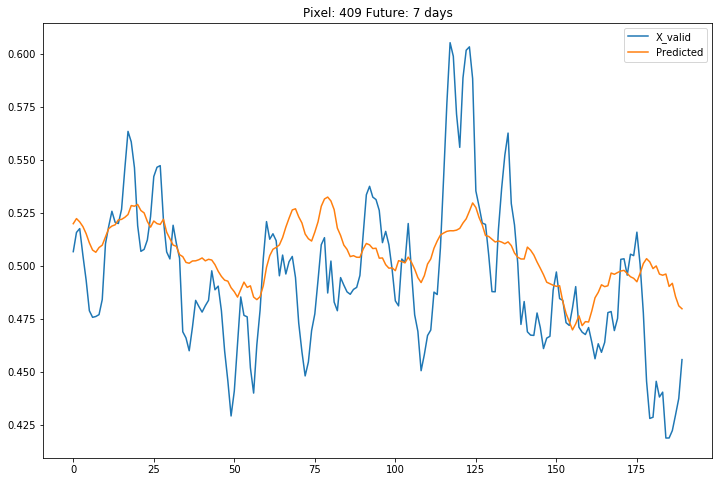

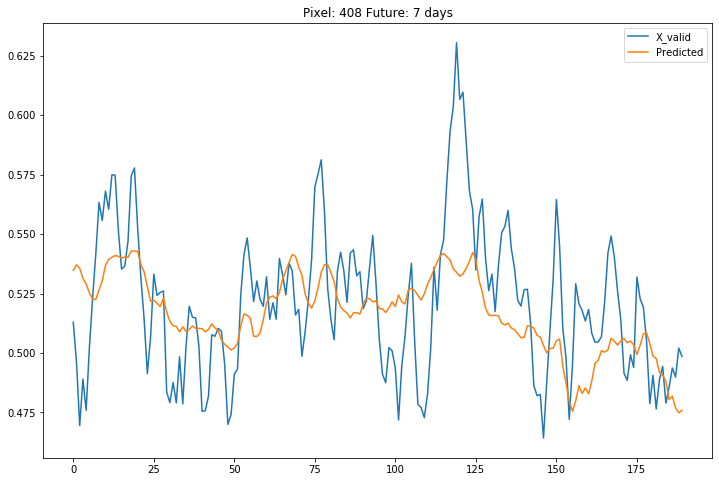

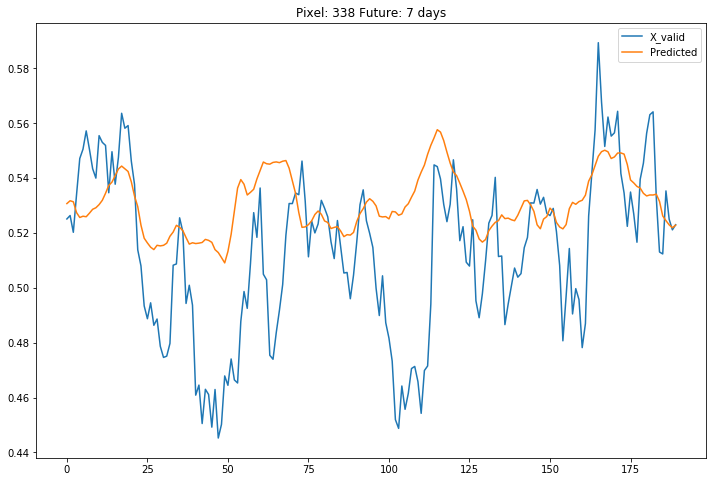

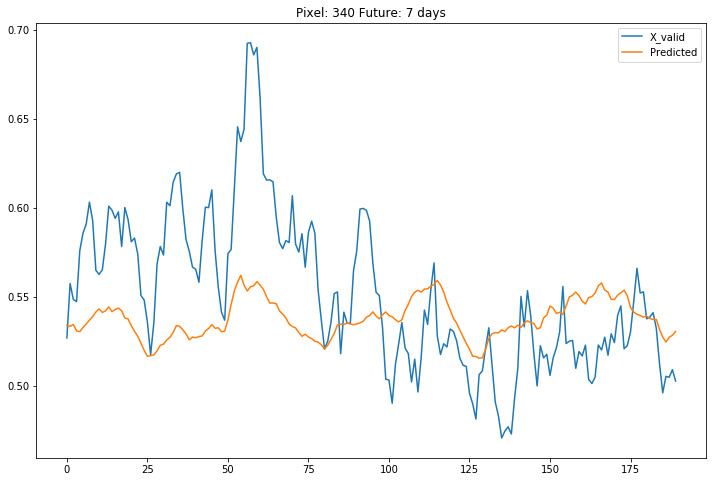

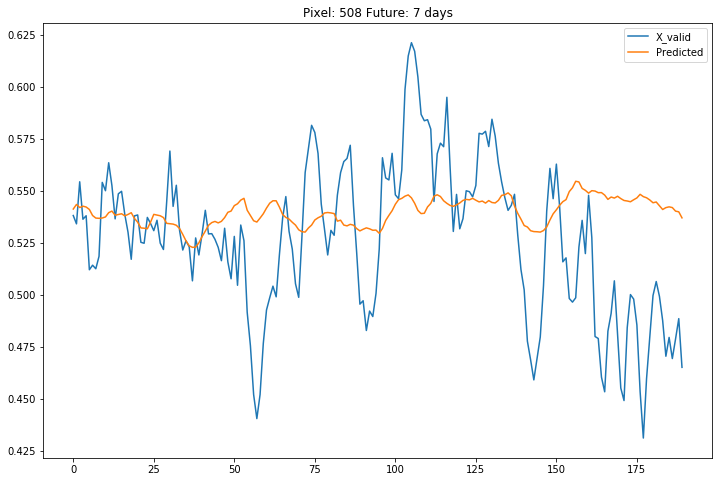

...

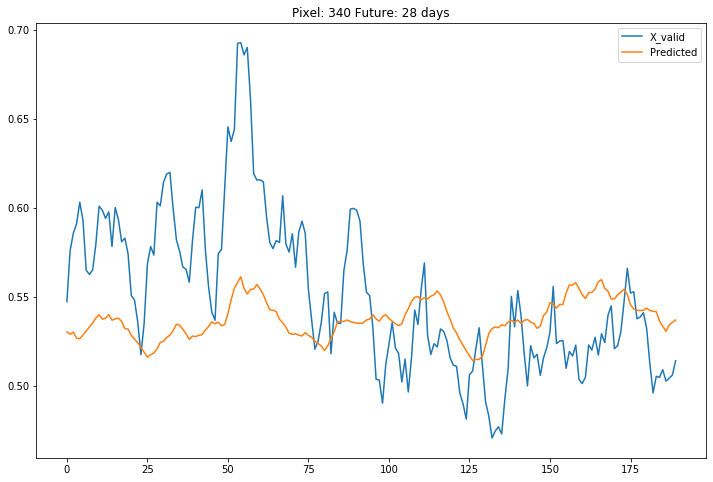

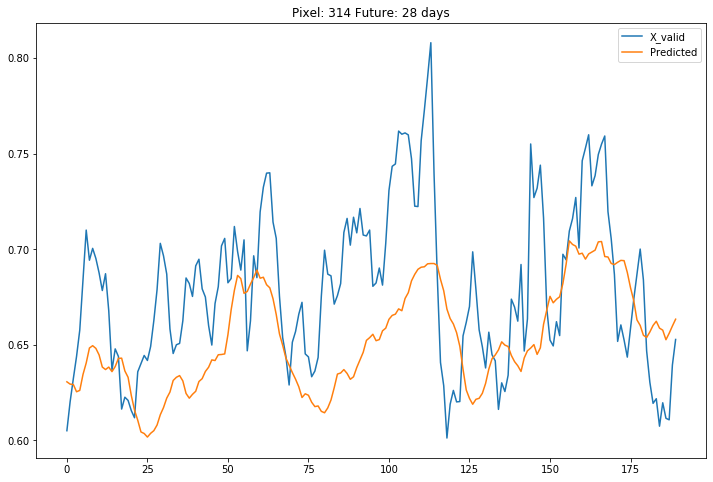

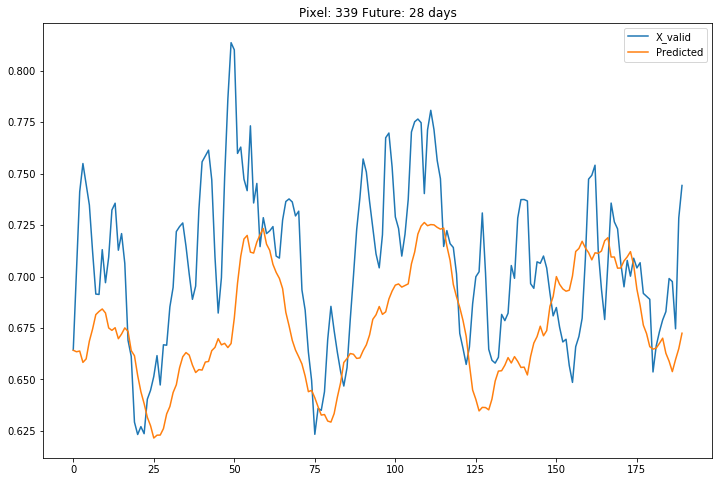

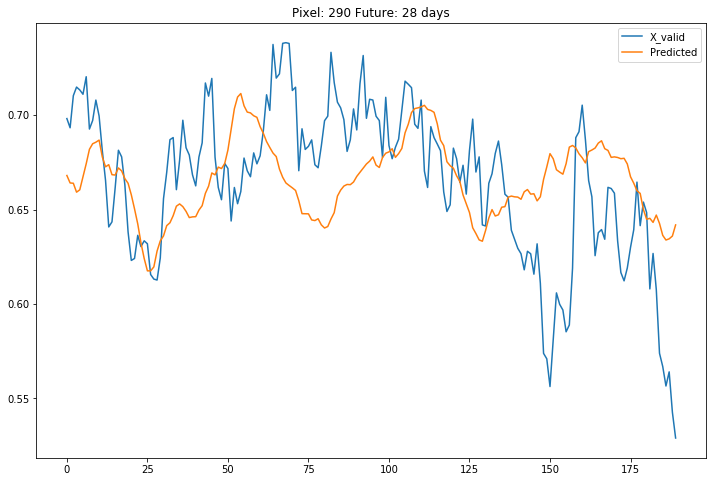

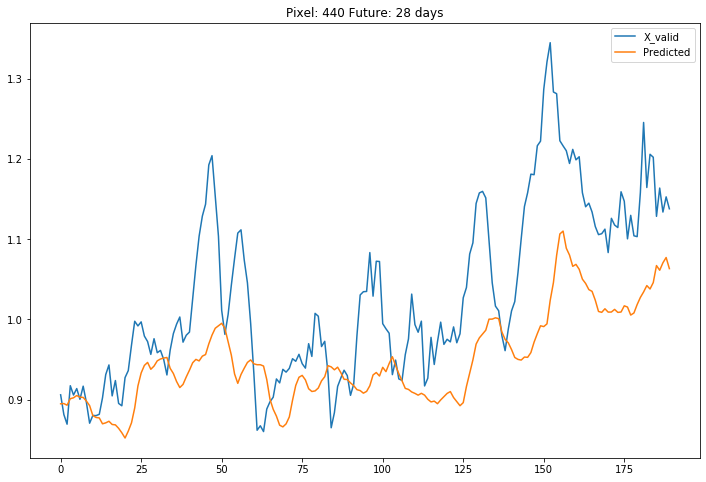

In [53]:
Predict = model.predict([X_valid])

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        pd.DataFrame(np.transpose(np.vstack([Y_valid[:,ts,i],Predict[:,ts,i]])),
                     columns=["X_valid","Predicted"]).plot(figsize=(12,8),
                                                           title="Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")

## EN_DEC LSTM Attention

In [88]:
# Sometimes helpful to implement own softmax activation function to
# better manage calculations along specific axes.
def softmax_activation(x):
    e = K.exp(x - K.max(x, axis=1, keepdims=True))
    s = K.sum(e, axis=1, keepdims=True)
    return e / s

In [117]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
X = Reshape((time_step, units))(X)
print()
h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

outputList = list()
for t in range(Y_train.shape[1] + 1):
    #build output for a single timestep
    h_prev_repeat = RepeatVector(time_step)(h_prev)
    joined = Concatenate(axis=-1)([X, h_prev_repeat])
    joined = Dense(int(joined.shape[2]), kernel_initializer = 'glorot_uniform', activation="tanh", name=f'attention_mid_dense_'+str(t))(joined)
    e_vals = Dense(1, kernel_initializer = 'glorot_uniform', activation='linear',  name=f'attention_final_dense_'+str(t))(joined)
    alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    #alphas = Activation('softmax', name=f'attention_softmax_'+str(t))(e_vals)
    attentions = Dot(axes=1)([alphas, X])
    #save states from previous batch 
    h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    
    if (t>0):
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='EN_DEC_LSTM_ATTENTION')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)



(None, 52, 25, 25, 1)

stack:  (None, 4, 625)
Model: "EN_DEC_LSTM_ATTENTION"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_32 (InputLayer)           [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_31 (TimeDistri (None, 52, 625)      0           input_32[0][0]                   
__________________________________________________________________________________________________
lstm_49 (LSTM)                  (None, 52, 100)      290400      time_distributed_31[0][0]        
__________________________________________________________________________________________________
h_start (InputLayer)            [(None, 100)]        0                                            
________________________________

In [118]:
h_start = np.zeros((X_train.shape[0], units*factor))
c_start = np.zeros((X_train.shape[0], units*factor))
h_startv = np.zeros((X_valid.shape[0], units*factor))
c_startv = np.zeros((X_valid.shape[0], units*factor))

EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train,h_start, c_start],y=Y_train, 
                             validation_data=([X_valid,h_startv, c_startv], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "EN_DEC_LSTM_ATTENTION"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_32 (InputLayer)           [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_31 (TimeDistri (None, 52, 625)      0           input_32[0][0]                   
__________________________________________________________________________________________________
lstm_49 (LSTM)                  (None, 52, 100)      290400      time_distributed_31[0][0]        
__________________________________________________________________________________________________
h_start (InputLayer)            [(None, 100)]        0                                            
______________________________________________________________________________

Epoch 1/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0522 - mae: 0.0522
Epoch 00001: val_loss improved from inf to 0.02976, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200725-152216_model.hdf5
573/573 [==============================] - 7s 13ms/sample - loss: 0.0512 - mae: 0.0512 - val_loss: 0.0298 - val_mae: 0.0298
Epoch 2/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0137 - mae: 0.0137
Epoch 00002: val_loss improved from 0.02976 to 0.00881, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200725-152216_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0131 - mae: 0.0131 - val_loss: 0.0088 - val_mae: 0.0088
Epoch 3/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0058 - mae: 0.0058
Epoch 00003: val_loss improved 

Epoch 24/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0045 - mae: 0.0045
Epoch 00024: val_loss improved from 0.00679 to 0.00674, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200725-152216_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0045 - mae: 0.0045 - val_loss: 0.0067 - val_mae: 0.0067
Epoch 25/500
567/573 [============================>.] - ETA: 0s - loss: 0.0043 - mae: 0.0043
Epoch 00025: val_loss improved from 0.00674 to 0.00667, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200725-152216_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0043 - mae: 0.0043 - val_loss: 0.0067 - val_mae: 0.0067
Epoch 26/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0043 - mae: 0.0043
Epoch 00026: val_loss imp

Epoch 51/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00051: val_loss did not improve from 0.00642
573/573 [==============================] - 1s 1ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 52/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0040 - mae: 0.0040
Epoch 00052: val_loss did not improve from 0.00642
573/573 [==============================] - 1s 1ms/sample - loss: 0.0040 - mae: 0.0040 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 53/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00053: val_loss did not improve from 0.00642
573/573 [==============================] - 1s 1ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 54/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00054: val_loss did not improve from 0.00642
573/573 [==============================] - 1s 1ms/sampl

525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00079: val_loss did not improve from 0.00632
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 80/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00080: val_loss did not improve from 0.00632
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 81/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00081: val_loss did not improve from 0.00632
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 82/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00082: val_loss improved from 0.00632 to 0.00631, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Mast

Epoch 108/500
567/573 [============================>.] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00108: val_loss improved from 0.00618 to 0.00614, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200725-152216_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0061 - val_mae: 0.0061
Epoch 109/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00109: val_loss did not improve from 0.00614
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 110/500
567/573 [============================>.] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00110: val_loss did not improve from 0.00614
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 111/500
525/573 

Epoch 133/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00133: val_loss did not improve from 0.00583
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 134/500
567/573 [============================>.] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00134: val_loss did not improve from 0.00583
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 135/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00135: val_loss did not improve from 0.00583
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 136/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00136: val_loss improved from 0.00583 to 0.00582, saving model to /home/zhimin90/DePaul/CSC695/G

Epoch 160/500
567/573 [============================>.] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00160: val_loss did not improve from 0.00564
573/573 [==============================] - 1s 1ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 161/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00161: val_loss did not improve from 0.00564
573/573 [==============================] - 1s 1ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 162/500
567/573 [============================>.] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00162: val_loss improved from 0.00564 to 0.00557, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200725-152216_model.hdf5
573/573 [==============================] - 1s 2ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 163/500
546/573 

Epoch 189/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00189: val_loss did not improve from 0.00541
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 190/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00190: val_loss did not improve from 0.00541
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0055 - val_mae: 0.0055
Epoch 191/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00191: val_loss did not improve from 0.00541
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 192/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00192: val_loss did not improve from 0.00541
573/573 [==============================] - 1s 1ms/s

Epoch 219/500
567/573 [============================>.] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00219: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 220/500
567/573 [============================>.] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00220: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 221/500
567/573 [============================>.] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00221: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 222/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00222: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/s

Epoch 249/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00249: val_loss did not improve from 0.00536
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0054 - val_mae: 0.0054
Epoch 250/500
567/573 [============================>.] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00250: val_loss did not improve from 0.00536
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 251/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00251: val_loss did not improve from 0.00536
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0055 - val_mae: 0.0055
Epoch 252/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00252: val_loss did not improve from 0.00536
573/573 [==============================] - 1s 1ms/s

190/190 - 0s - loss: 0.0111 - mae: 0.0111
test_accuracy_MAE=0.011073293, test_loss=0.011073292684006064


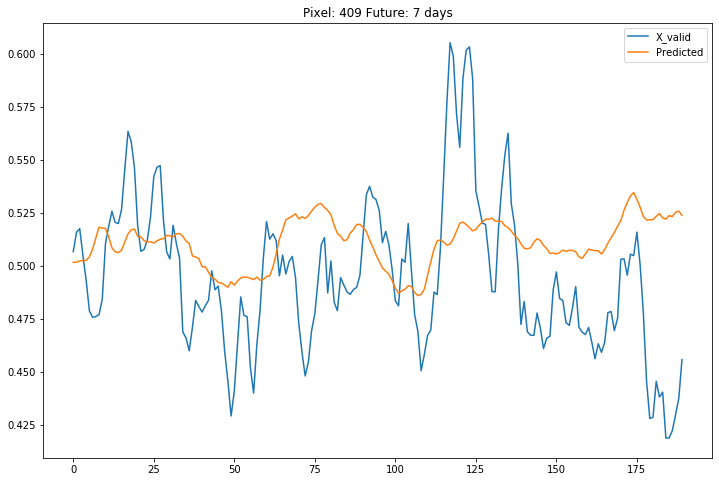

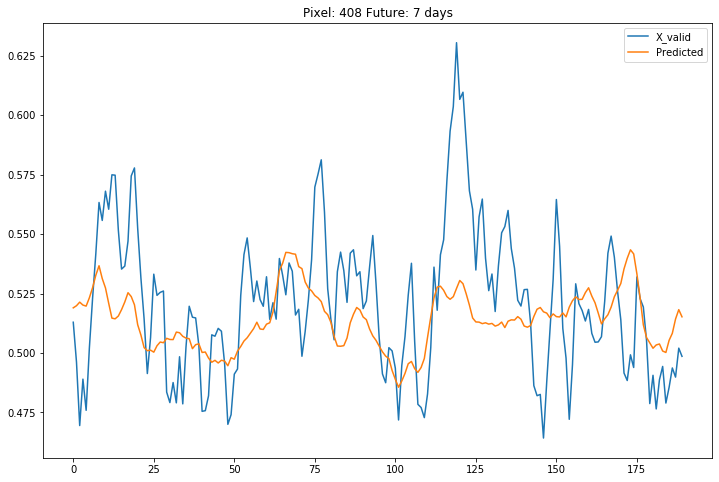

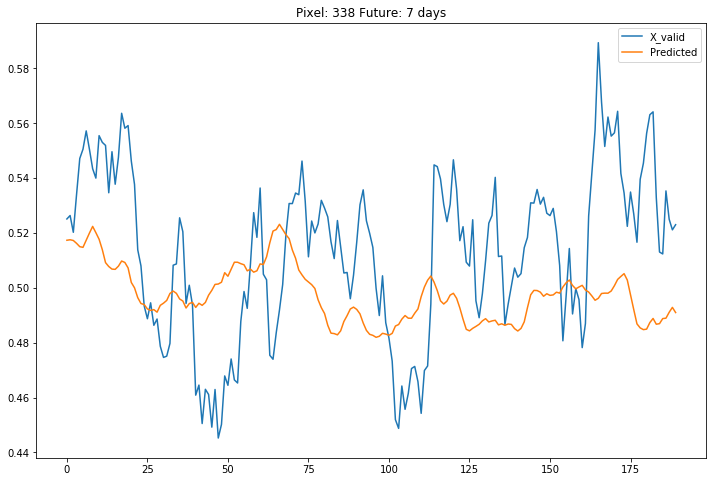

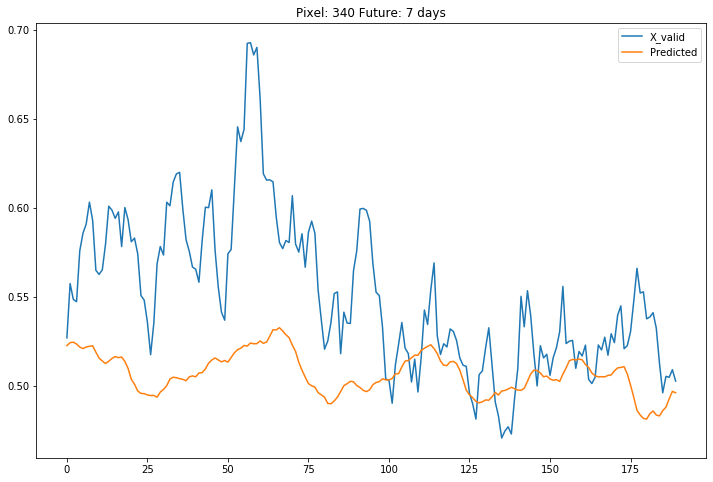

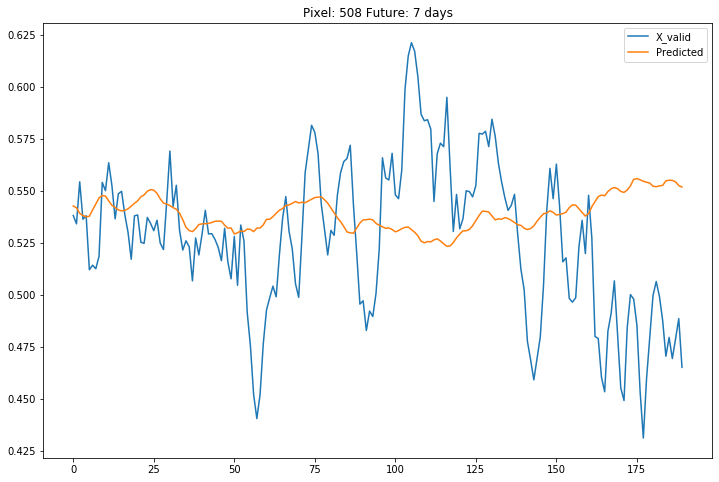

...

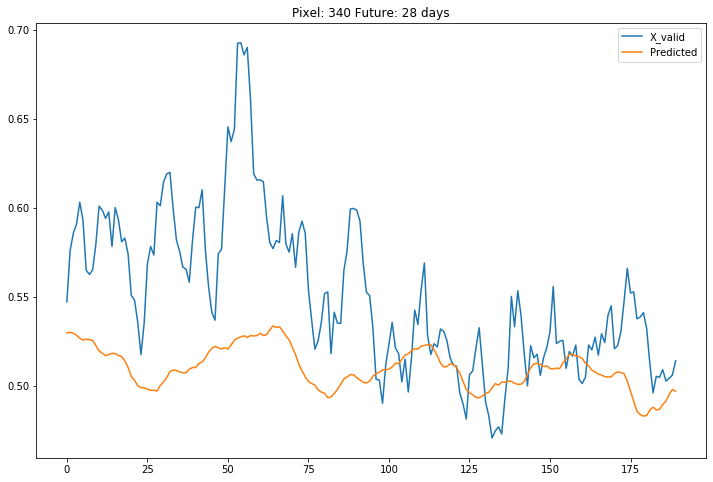

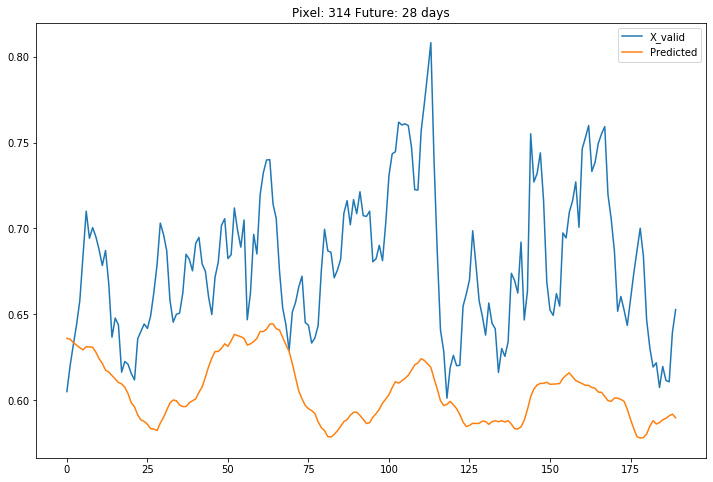

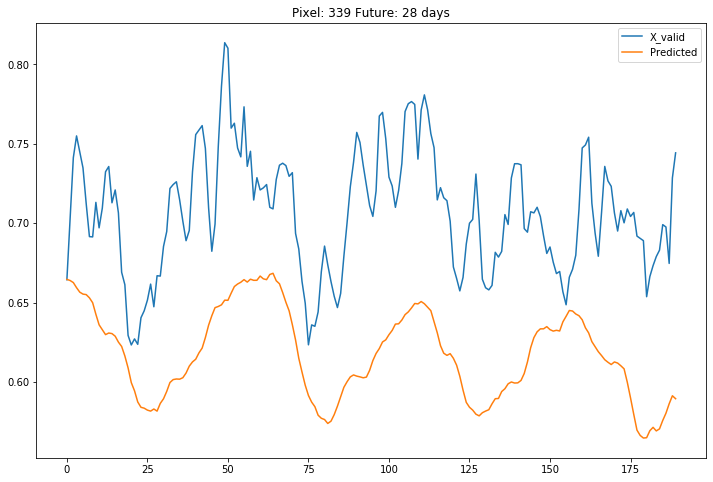

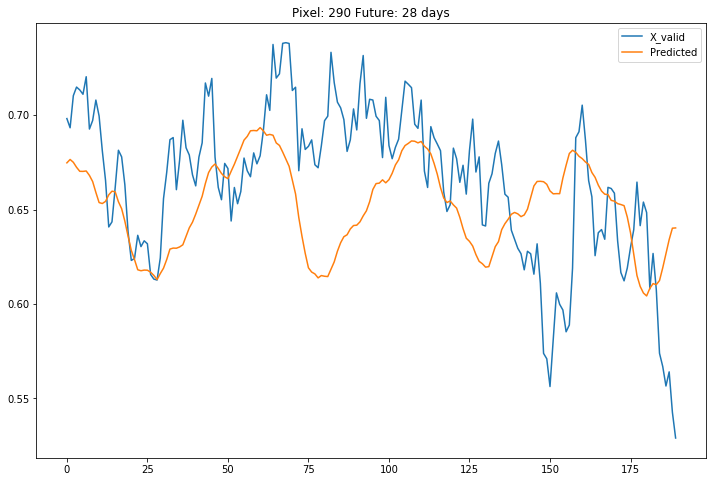

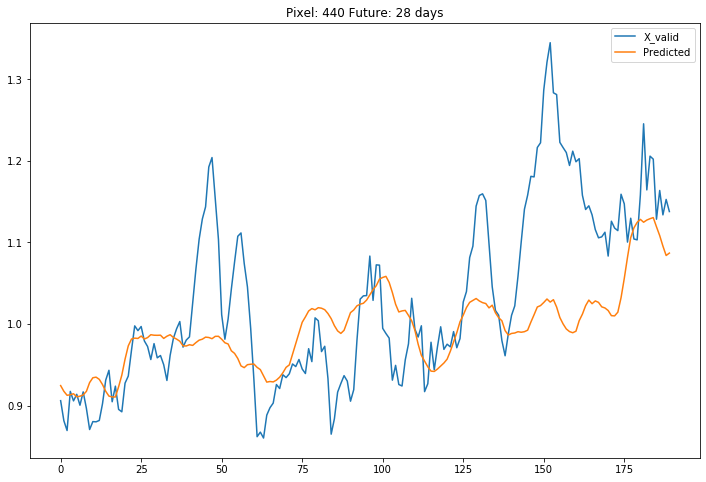

In [119]:
Predict = model.predict([X_valid,h_startv, c_startv])

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        pd.DataFrame(np.transpose(np.vstack([Y_valid[:,ts,i],Predict[:,ts,i]])),
                     columns=["X_valid","Predicted"]).plot(figsize=(12,8),
                                                           title="Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")

## Encoder + Decoder with LSTM for each timestep out

In [84]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
factor = 1
X = LSTM(units,return_sequences=True)(TimeDist)
print(X.shape)
X = Reshape((time_step, units))(X)
print(X.shape)
h_start = Input(shape=(units*factor,), name='h_start')
print("h_start.shape:",h_start.shape)
c_start = Input(shape=(units*factor,), name='c_start')
h_prev = h_start
c_prev = c_start

outputList = list()
for t in range(Y_train.shape[1]+1):
    h_prev, _, c_prev = LSTM(units*factor, return_state=True,name=f'layer_2_LSTM_{t}')(X, initial_state=[h_prev, c_prev])
    if t > 0:
        out = Dense(Y_train.shape[2],activation='linear', name=f'dense_output_{t}')(h_prev)
        outputList.append(out)
outputs = tf.stack(outputList,1)
print(outputs.shape)
model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='EN_DEC_LSTM')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)

(None, 52, 25, 25, 1)
(None, 52, 100)
(None, 52, 100)
h_start.shape: (None, 100)
(None, 4, 625)
Model: "EN_DEC_LSTM"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_22 (InputLayer)           [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_21 (TimeDistri (None, 52, 625)      0           input_22[0][0]                   
__________________________________________________________________________________________________
lstm_39 (LSTM)                  (None, 52, 100)      290400      time_distributed_21[0][0]        
__________________________________________________________________________________________________
reshape_20 (Reshape)            (None, 52, 100)      0           lstm_39[0][0]             

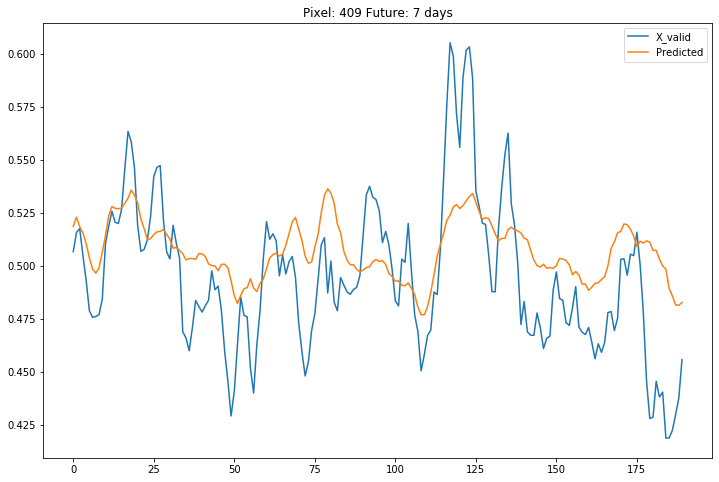

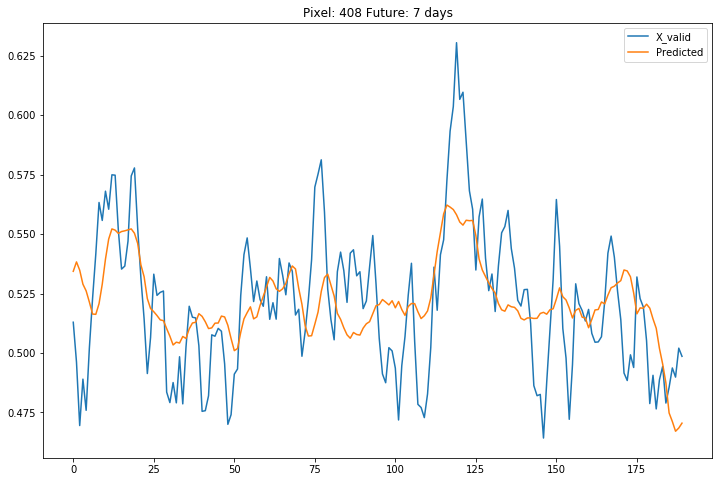

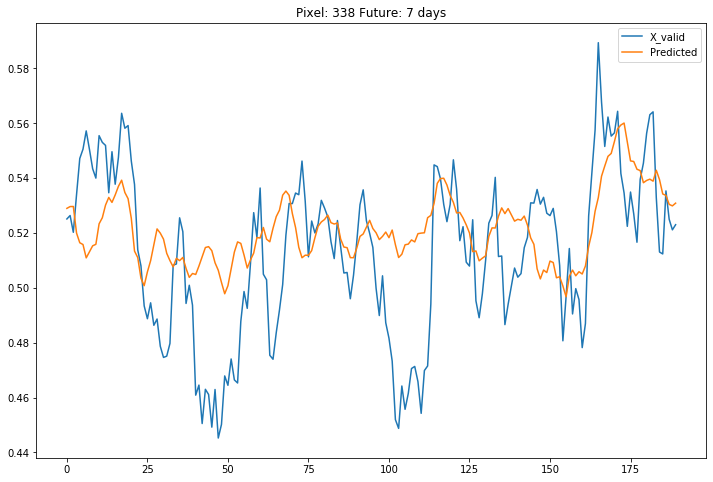

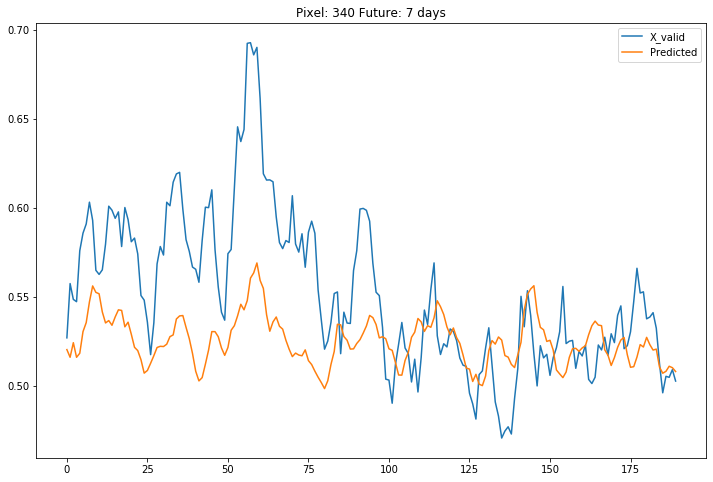

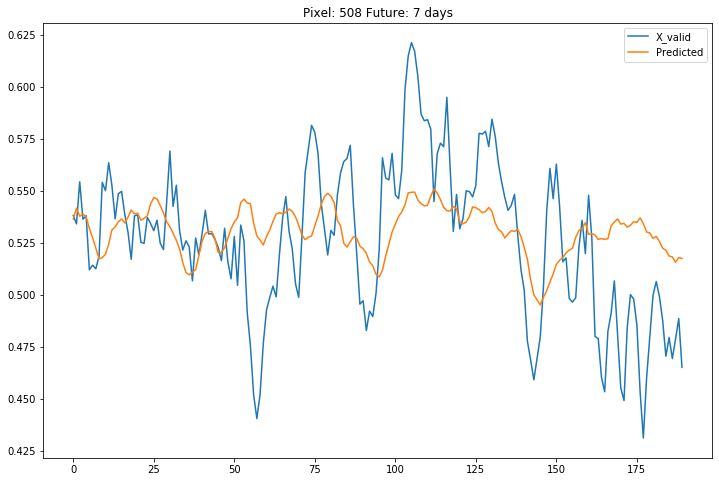

...

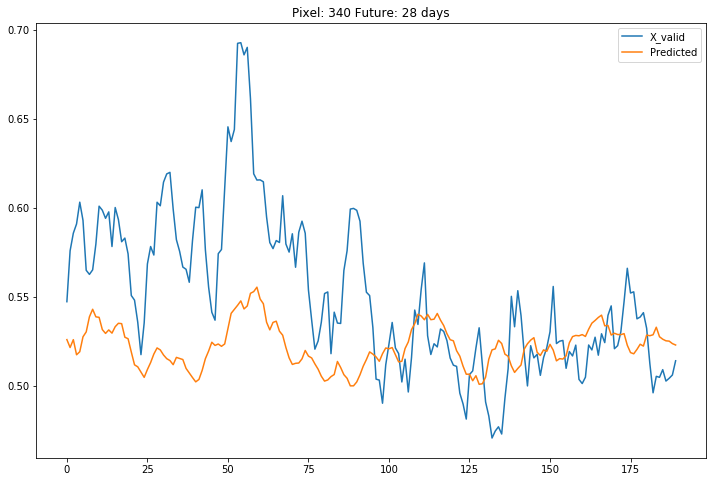

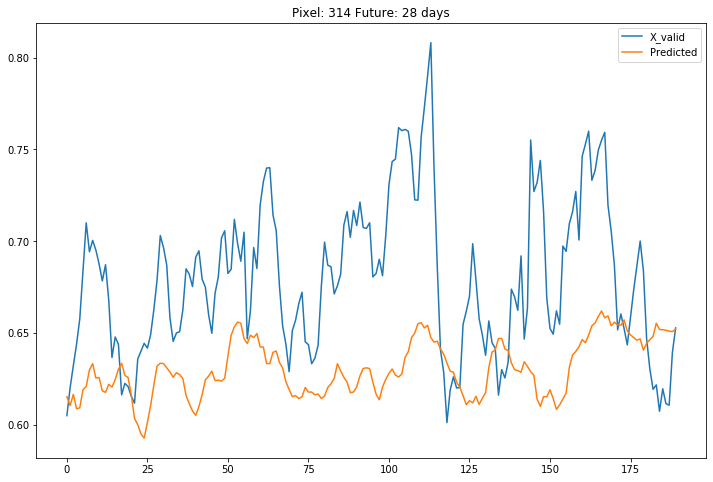

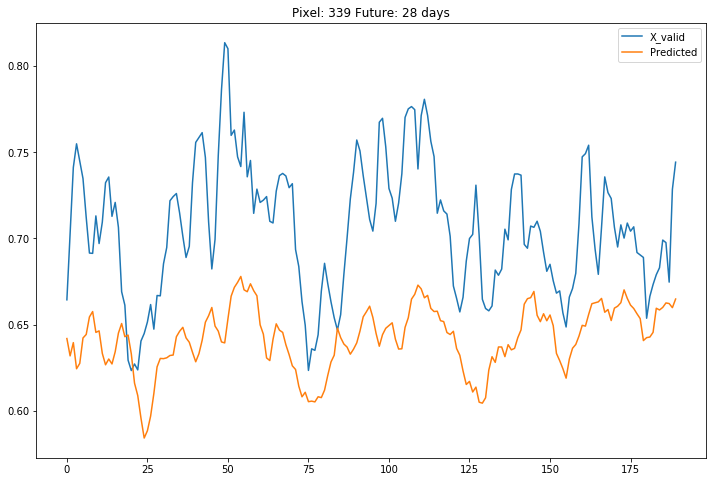

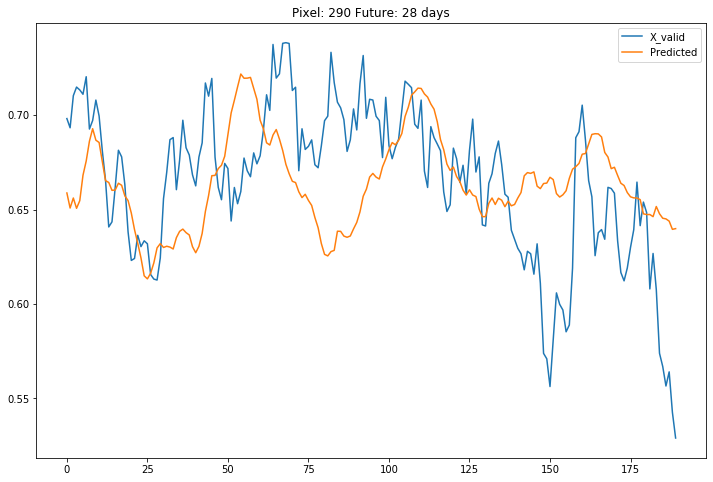

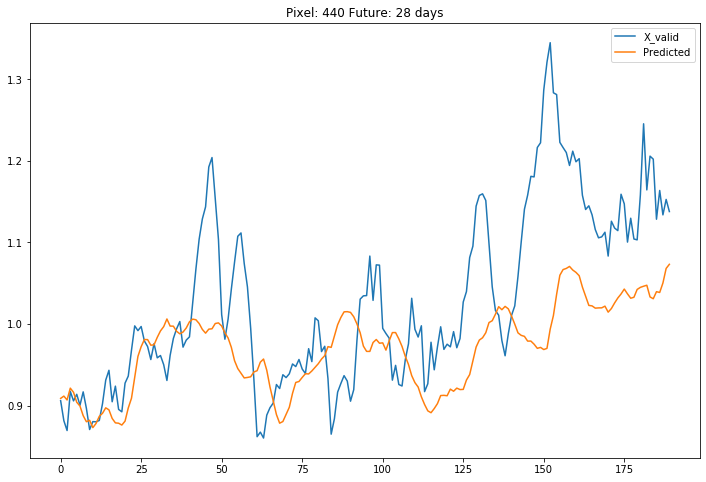

In [87]:
Predict = model.predict([X_valid,h_startv, c_startv])

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        pd.DataFrame(np.transpose(np.vstack([Y_valid[:,ts,i],Predict[:,ts,i]])),
                     columns=["X_valid","Predicted"]).plot(figsize=(12,8),
                                                           title="Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")

## LSTM + Attention on LSTM units frequency

In [155]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
X = Reshape((time_step, units))(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

print("X.shape",X.shape)
print("h_prev.shape",h_prev.shape)

timeDist = Permute([2, 1])(X) #transpose for FFT. FFT library treats the last dimension as time
print('timeDist.shape',timeDist.shape)
fftLayer = Lambda(lambda x : tf.math.abs(tf.signal.rfft(x)))(timeDist) ## transform to frequency domain with TF
print('fftLayer.shape',fftLayer.shape)
fftLayer  = Permute([2, 1], name="fft_out")(fftLayer)#transpose back for the following shape
print('fftLayer.shape',fftLayer.shape) #Hc_i

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    #build output for a single timestep
    #h_prev_repeat = RepeatVector(time_step)(h_prev)
    #h_prev_repeat = RepeatVector(units)(h_prev)
    #print("h_prev_repeat.shape",h_prev_repeat.shape)
    #joined = Concatenate(axis=-1)([X, h_prev_repeat])
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_mid_dense_'+str(t))(X) #Wa
    print("joined.shape",joined.shape)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([fftLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_final_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    #alphas = Activation('softmax', name=f'attention_softmax_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, fftLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    print("h_prev.shape",h_prev.shape)
    if (t>0):
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_UNITs')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
X.shape (None, 52, 100)
h_prev.shape (None, 100)
timeDist.shape (None, 100, 52)
fftLayer.shape (None, 100, 27)
fftLayer.shape (None, 27, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
h_prev.shape (None, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
h_prev.shape (None, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
h_prev.shape (None, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
h_prev.shape (None, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (N

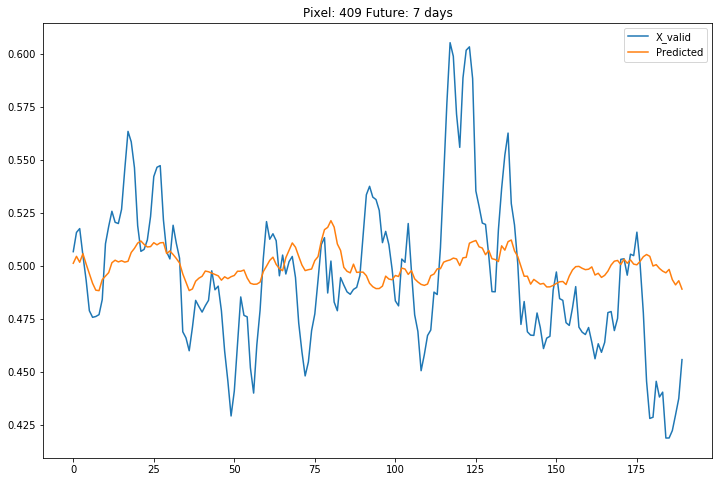

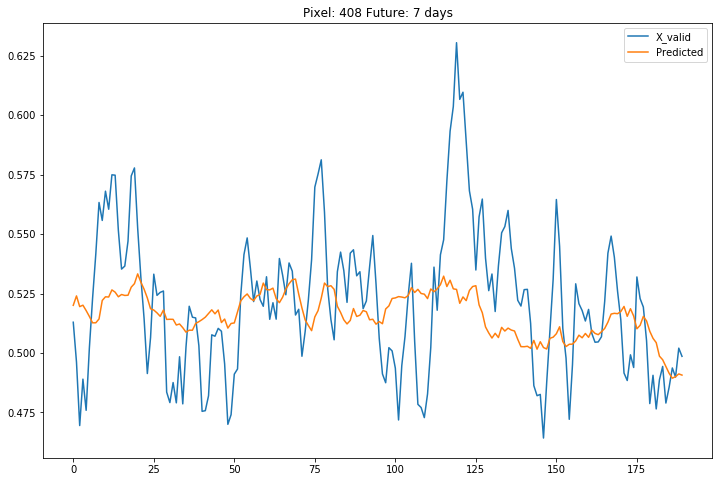

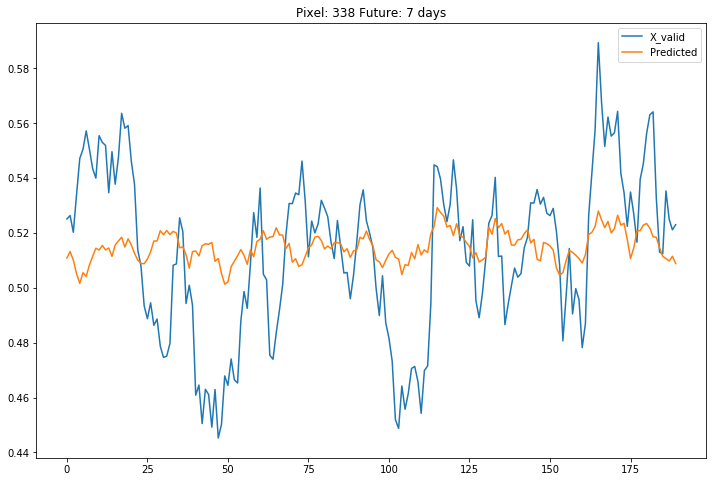

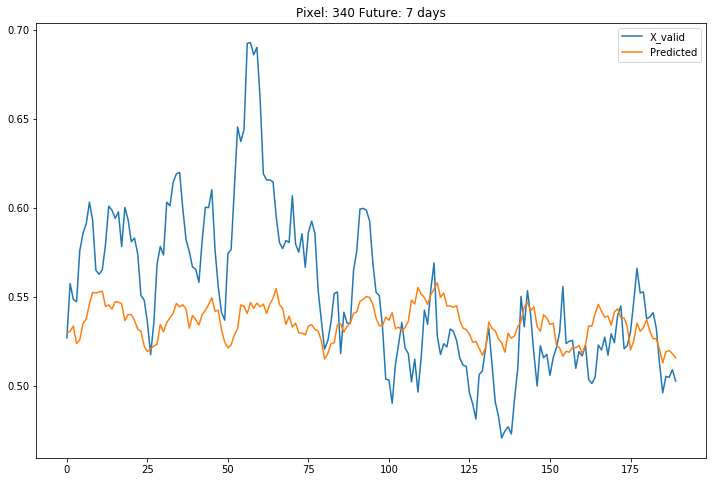

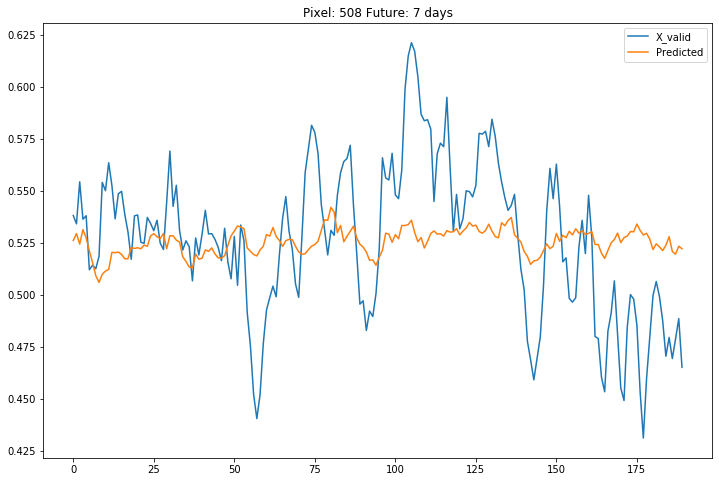

...

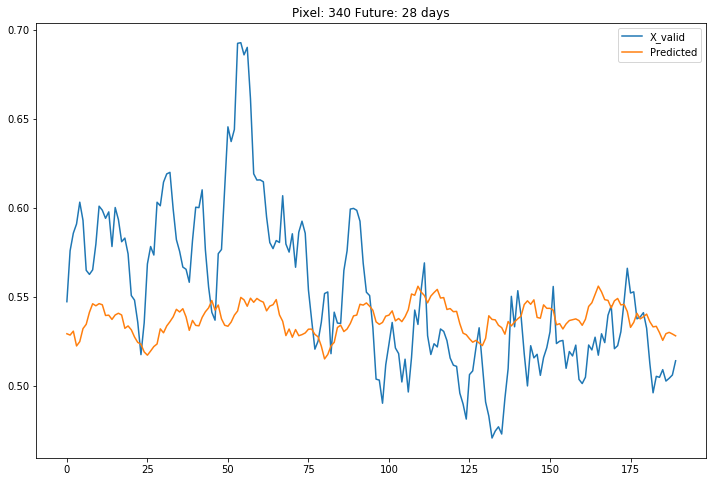

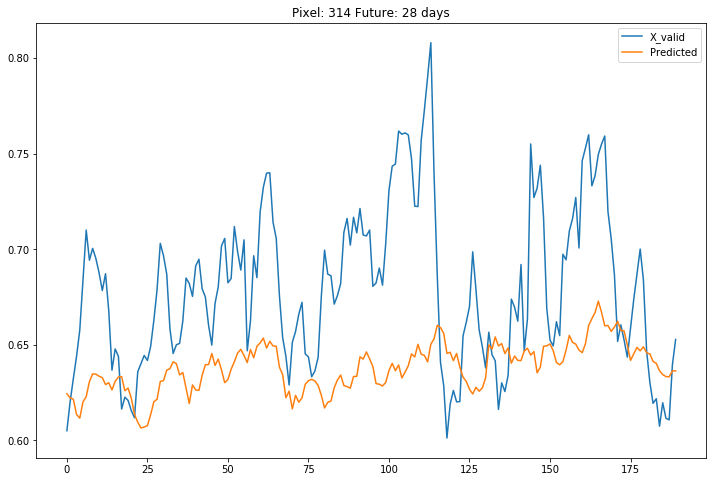

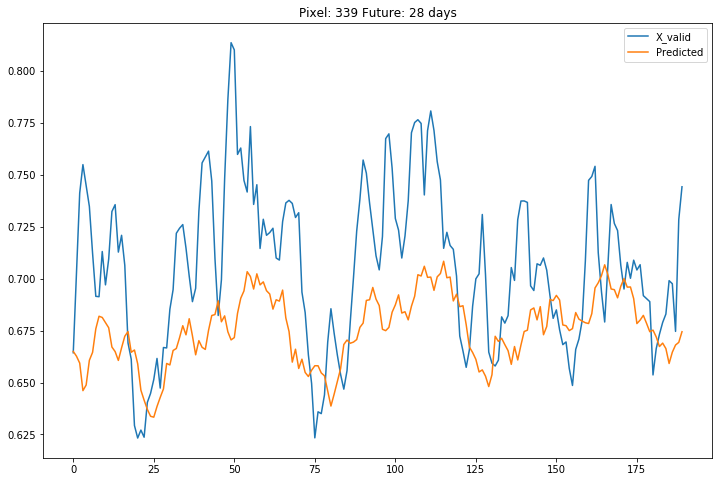

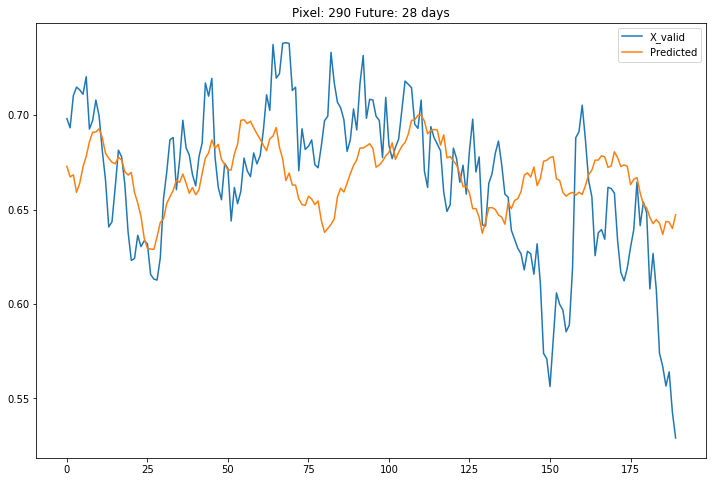

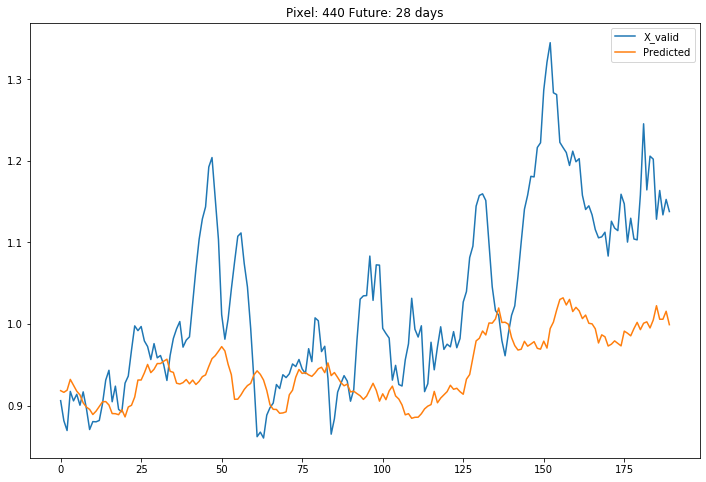

In [159]:
Predict = model.predict([X_valid,h_startv, c_startv])

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        pd.DataFrame(np.transpose(np.vstack([Y_valid[:,ts,i],Predict[:,ts,i]])),
                     columns=["X_valid","Predicted"]).plot(figsize=(12,8),
                                                           title="Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")

## ---------------------> Run fit on any of the previous model here <--------------------------

In [157]:
h_start = np.zeros((X_train.shape[0], units*factor))
c_start = np.zeros((X_train.shape[0], units*factor))
h_startv = np.zeros((X_valid.shape[0], units*factor))
c_startv = np.zeros((X_valid.shape[0], units*factor))

In [158]:
EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train,h_start, c_start],y=Y_train, 
                             validation_data=([X_valid,h_startv, c_startv], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "LSTM_ATTENTION_UNITs"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_64 (InputLayer)           [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_63 (TimeDistri (None, 52, 625)      0           input_64[0][0]                   
__________________________________________________________________________________________________
lstm_81 (LSTM)                  (None, 52, 100)      290400      time_distributed_63[0][0]        
__________________________________________________________________________________________________
reshape_62 (Reshape)            (None, 52, 100)      0           lstm_81[0][0]                    
_______________________________________________________________________________

Epoch 1/500
567/573 [============================>.] - ETA: 0s - loss: 0.0535 - mae: 0.0535
Epoch 00001: val_loss improved from inf to 0.03256, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [==============================] - 7s 12ms/sample - loss: 0.0533 - mae: 0.0533 - val_loss: 0.0326 - val_mae: 0.0326
Epoch 2/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0165 - mae: 0.0165
Epoch 00002: val_loss improved from 0.03256 to 0.00897, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0158 - mae: 0.0158 - val_loss: 0.0090 - val_mae: 0.0090
Epoch 3/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0059 - mae: 0.0059
Epoch 00003: val_loss improved 

573/573 [==============================] - 1s 1ms/sample - loss: 0.0048 - mae: 0.0048 - val_loss: 0.0070 - val_mae: 0.0070
Epoch 26/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0048 - mae: 0.0048
Epoch 00026: val_loss did not improve from 0.00699
573/573 [==============================] - 1s 1ms/sample - loss: 0.0048 - mae: 0.0048 - val_loss: 0.0072 - val_mae: 0.0072
Epoch 27/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0048 - mae: 0.0048
Epoch 00027: val_loss did not improve from 0.00699
573/573 [==============================] - 1s 1ms/sample - loss: 0.0048 - mae: 0.0048 - val_loss: 0.0071 - val_mae: 0.0071
Epoch 28/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0047 - mae: 0.0047
Epoch 00028: val_loss improved from 0.00699 to 0.00692, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [================

Epoch 52/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00052: val_loss did not improve from 0.00635
573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 53/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00053: val_loss did not improve from 0.00635
573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 54/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00054: val_loss did not improve from 0.00635
573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 55/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00055: val_loss did not improve from 0.00635
573/573 [==============================] - 1s 1ms/sampl

Epoch 82/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00082: val_loss did not improve from 0.00629
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 83/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00083: val_loss did not improve from 0.00629
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 84/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00084: val_loss did not improve from 0.00629
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 85/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00085: val_loss did not improve from 0.00629
573/573 [==============================] - 1s 1ms/sampl

573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0060 - val_mae: 0.0060
Epoch 110/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00110: val_loss improved from 0.00605 to 0.00601, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0060 - val_mae: 0.0060
Epoch 111/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00111: val_loss improved from 0.00601 to 0.00598, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0060 - val_mae: 

525/573 [==========================>...] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00134: val_loss improved from 0.00573 to 0.00566, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 135/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00135: val_loss improved from 0.00566 to 0.00566, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 136/500
567/573 [============================>.] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00136: val_loss improved from 

525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00156: val_loss improved from 0.00524 to 0.00520, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 157/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00157: val_loss improved from 0.00520 to 0.00513, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-103338_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 158/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00158: val_loss did not improv

Epoch 185/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00185: val_loss did not improve from 0.00508
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 186/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00186: val_loss did not improve from 0.00508
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 187/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00187: val_loss did not improve from 0.00508
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 188/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00188: val_loss did not improve from 0.00508
573/573 [==============================] - 1s 1ms/s

525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00214: val_loss did not improve from 0.00502
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 215/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00215: val_loss did not improve from 0.00502
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 216/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00216: val_loss did not improve from 0.00502
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 217/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0030 - mae: 0.0030
Epoch 00217: val_loss did not improve from 0.00502
573/573 [==============================] - 1s 1ms/sample - loss: 

Epoch 245/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00245: val_loss did not improve from 0.00502
573/573 [==============================] - 1s 1ms/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 246/500
567/573 [============================>.] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00246: val_loss did not improve from 0.00502
573/573 [==============================] - 1s 1ms/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 247/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00247: val_loss did not improve from 0.00502
573/573 [==============================] - 1s 1ms/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 248/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00248: val_loss did not improve from 0.00502
573/573 [==============================] - 1s 1ms/s

## LSTM

In [251]:
test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

191/191 - 0s - loss: 0.0071 - mae: 0.0071
test_accuracy_MAE=0.0071155345, test_loss=0.007115534845622578


## EN_DEC LSTM + Attention

In [308]:
test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

191/191 - 0s - loss: 0.0072 - mae: 0.0072
test_accuracy_MAE=0.0072214953, test_loss=0.007221495420598859


## Validation set result 25x25 pixels

#### Flattened_Fully_Connected: valid_accuracy_MAE=0.0067913793, valid_loss=0.006791379331996304

#### Flattened_LTSM: valid_accuracy_MAE=0.004592653, valid_loss=0.004592652776380952

#### 2DCNN_LTSM: valid_accuracy_MAE=0.0053498237, valid_loss=0.005349824231859121

#### FLATTENED_LTSM_Attention: valid_accuracy_MAE=0.005595601, valid_loss=0.005595600854176345

#### Flattened_Attention_Time: valid_accuracy_MAE=0.0058029336, valid_loss=0.0058029338117708395

#### Attention_FFT: valid_accuracy_MAE=0.0062100464, valid_loss=0.00621004617426798

#### Attention_Time_FFT_STFT: valid_accuracy_MAE=0.0058276486, valid_loss=0.005827648562735132

#### TimeDistributed_attention: valid_accuracy_MAE=0.006259729, valid_loss=0.006259729208044356

#### TimeDistributed_attention1_plus_attention2_on_time: valid_accuracy_MAE=0.006148583, valid_loss=0.006148582597443571

#### 2 headed TimeDistributed_attention1_plus_attention2_on_time: valid_accuracy_MAE=0.0058226553, valid_loss=0.005822655369395985

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
logs_base_dir = "./logs"
os.makedirs(logs_base_dir, exist_ok=True)
%tensorboard --logdir {logs_base_dir}

In [148]:
Predict = model.predict([X_valid,h_startv, c_startv])

In [149]:
def reshapePred(Predict, fromLast=1):
    return np.rot90(Predict[-1*fromLast].reshape(int(Predict[-1*fromLast].shape[0]**(1/2)),int(Predict[-1*fromLast].shape[0]**(1/2))))

In [150]:
vmax, vmin = np.max(Predict),np.min(Predict)
vmax, vmin

(0.9415091, -0.004546633)

In [151]:
dvmax, dvmin = np.max(np.abs(Predict-Y_valid)),np.min(np.abs(Predict-Y_valid))
dvmax, dvmin

(0.46981318369517644, 1.1932570487260818e-08)

In [152]:
diff_max,diff_min = (dvmax , dvmin ) 
def scaleDiff(diff,diff_max,diff_min):
    return (diff - diff_min)/(diff_max - diff_min)

#### We chart autocorrelation

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

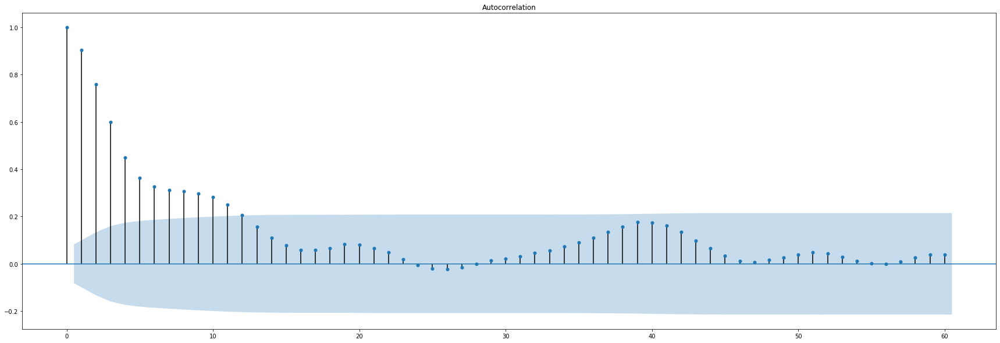

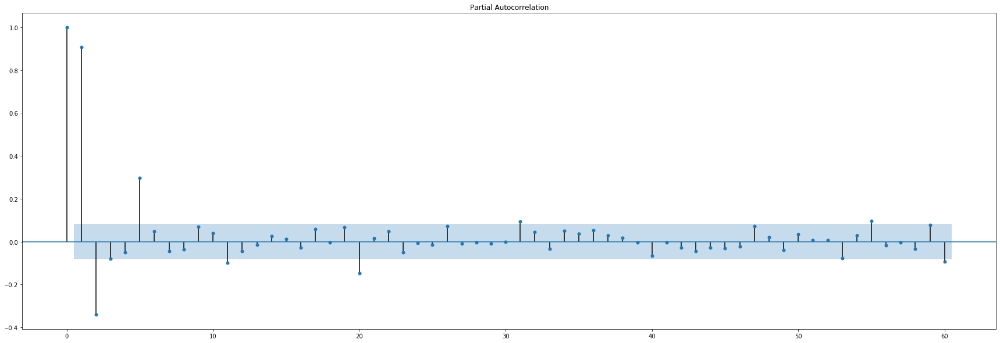

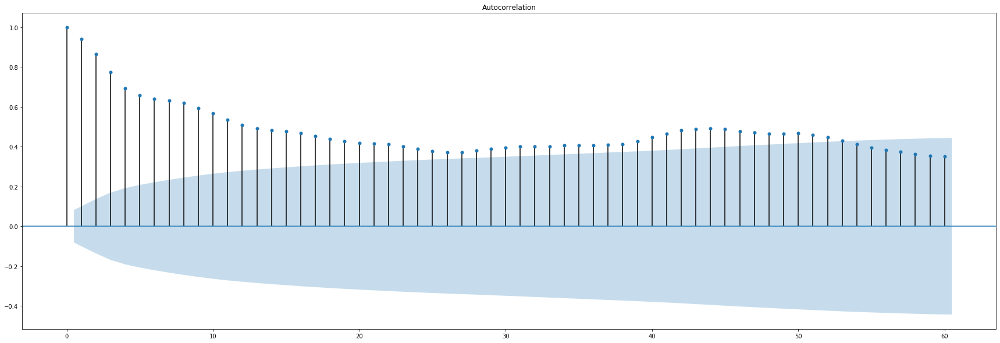

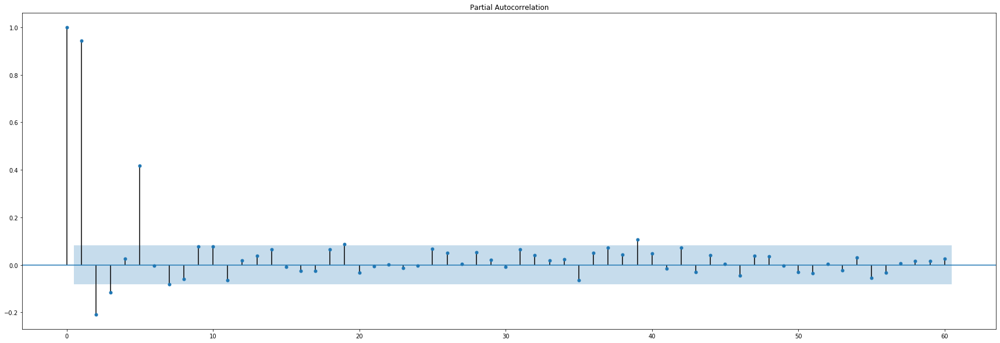

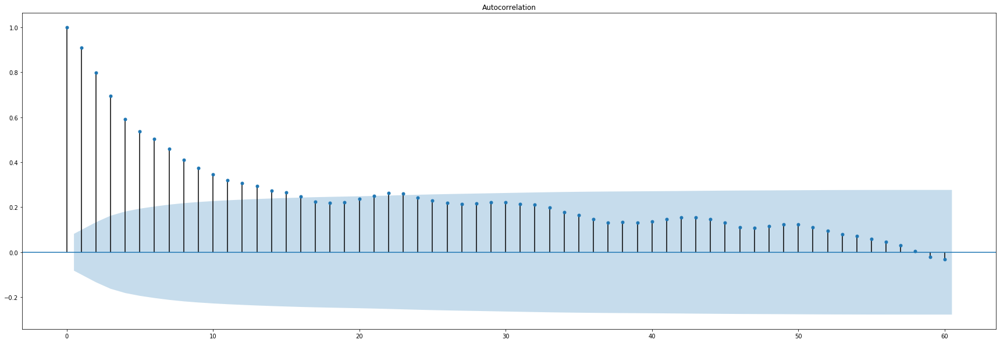

...

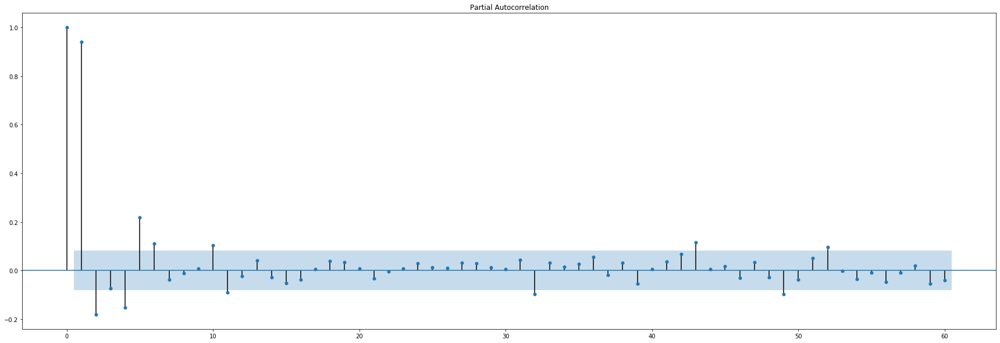

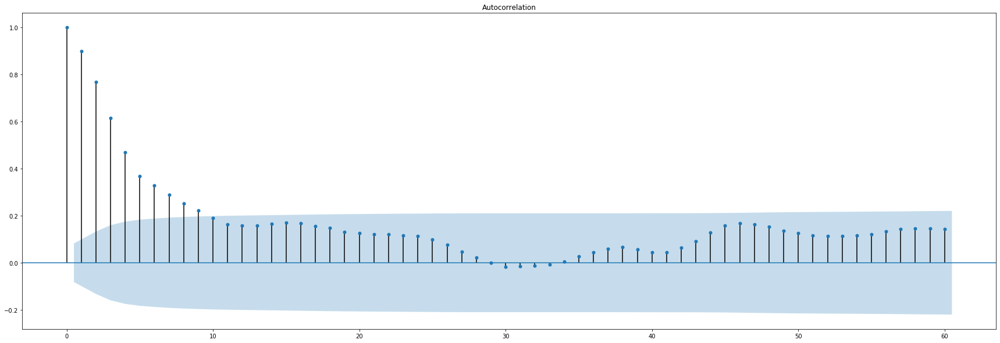

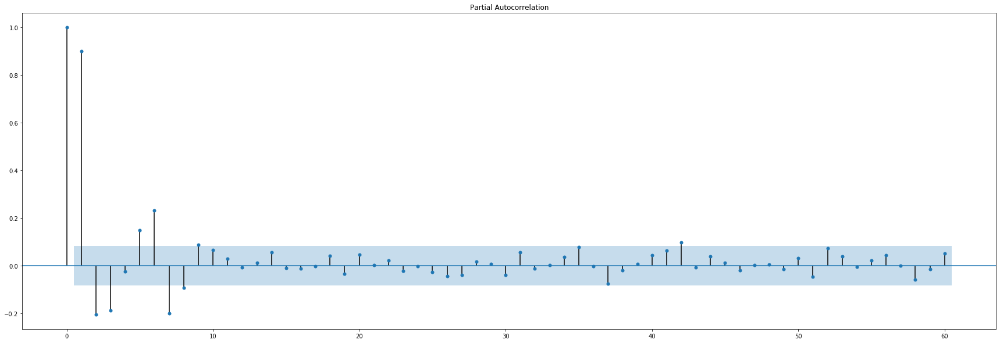

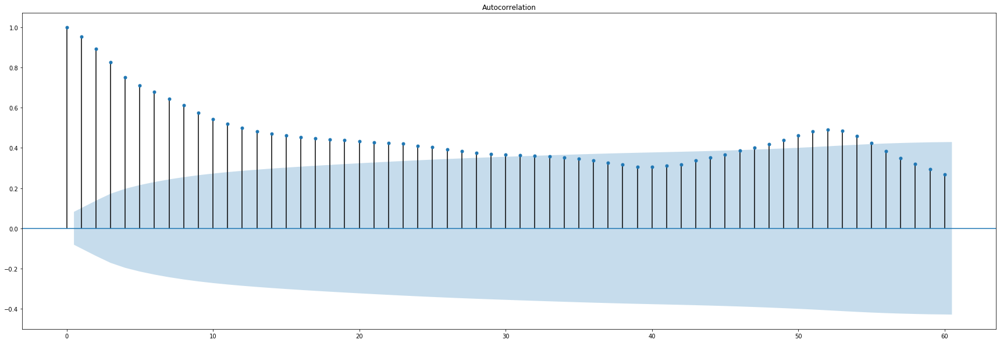

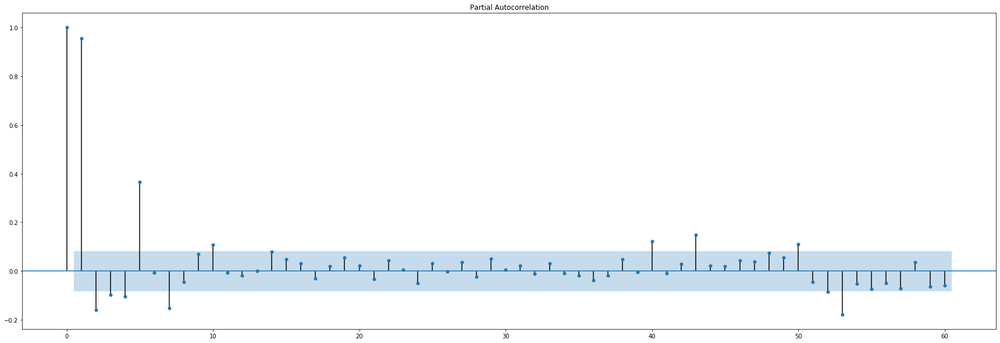

In [52]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
import matplotlib as mpl

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        series = pd.DataFrame(np.transpose(np.vstack([Y_train[:,ts,i]])),columns=["Y_train"])
        with mpl.rc_context():
            mpl.rc("figure", figsize=(30,10))
            plot_acf(series,lags=60)
            plot_pacf(series,lags=60)

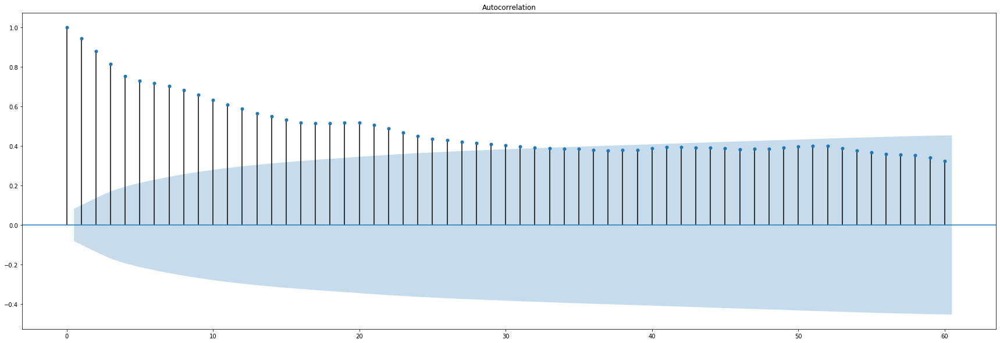

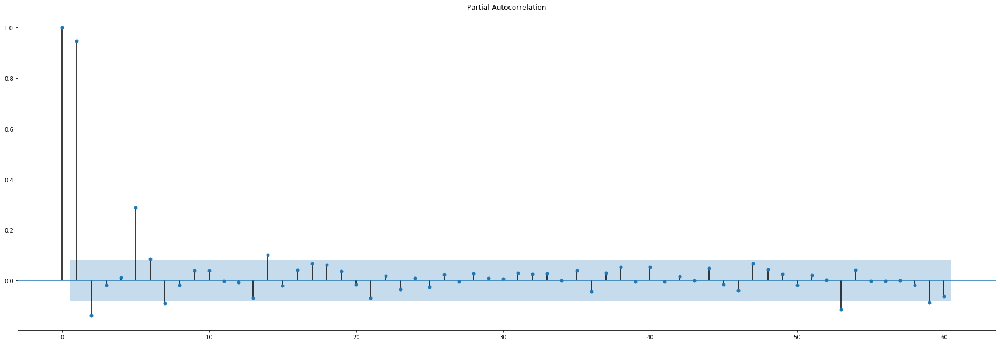

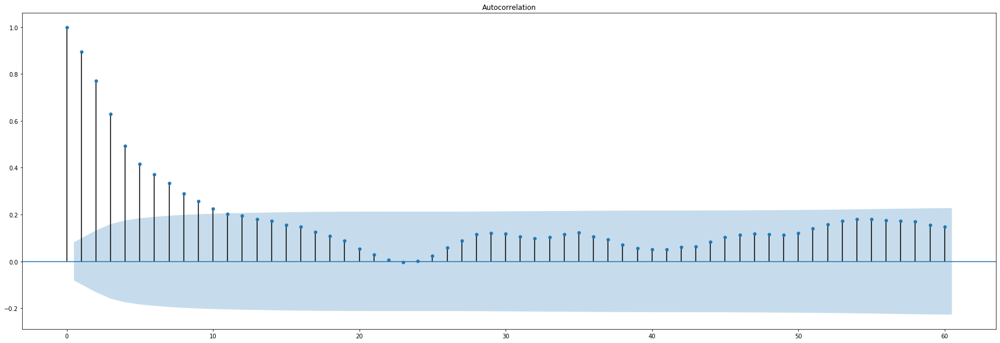

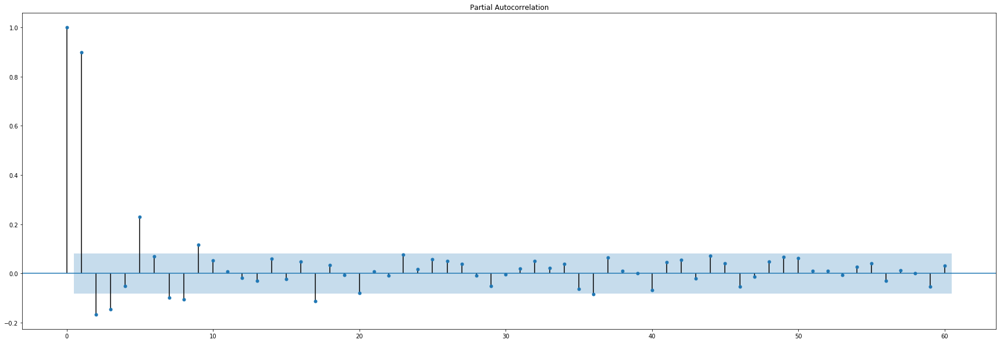

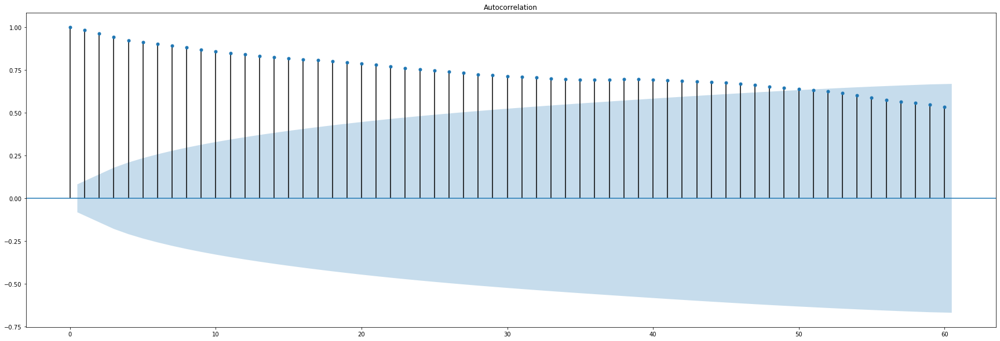

...

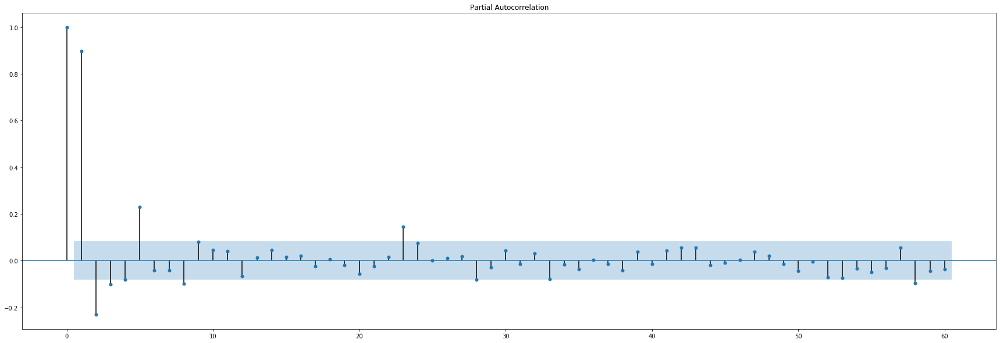

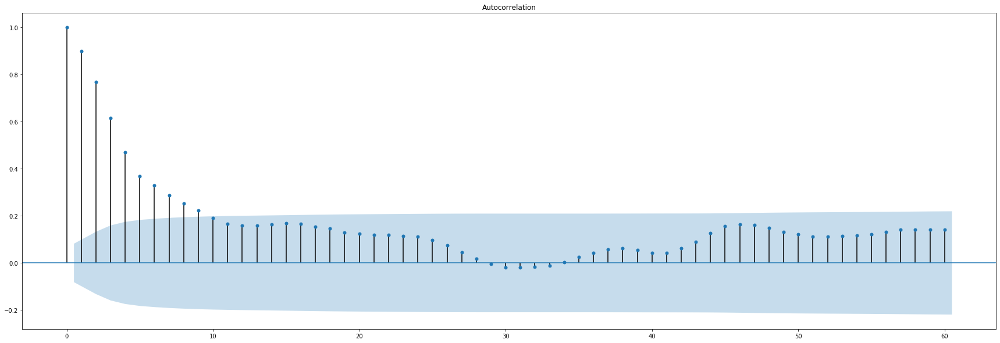

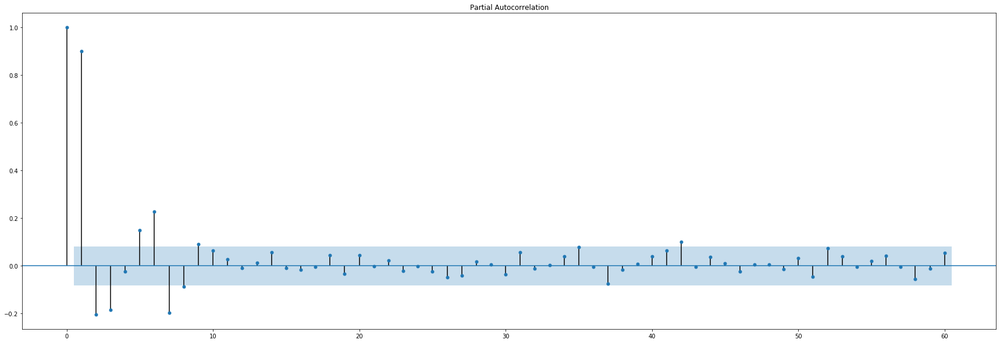

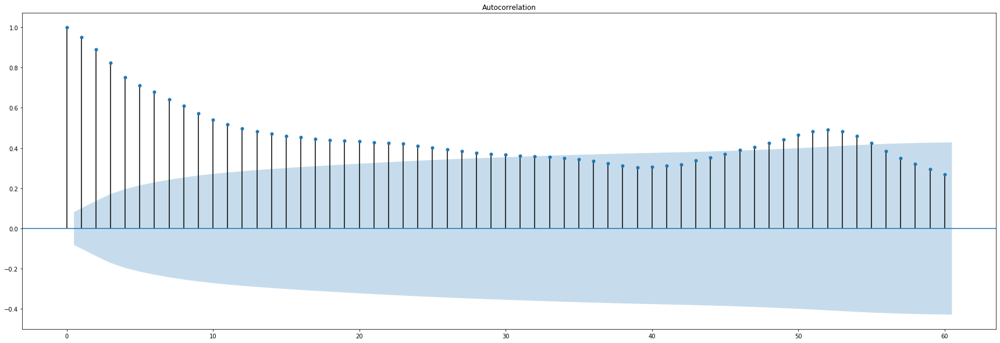

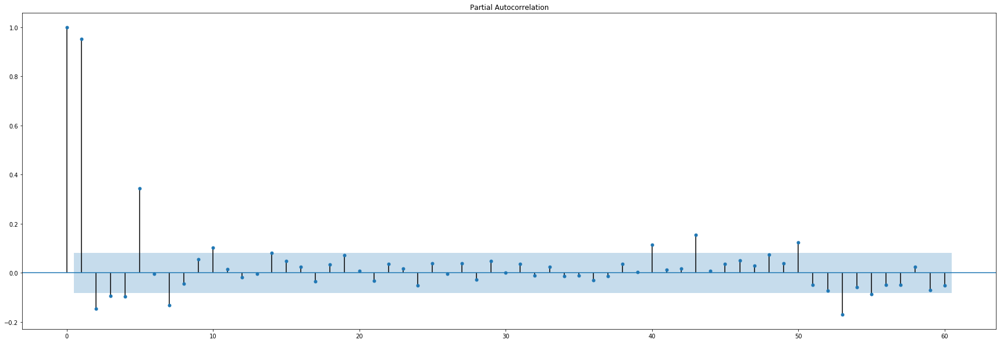

In [153]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
import matplotlib as mpl

for i in np.argsort(Y_train)[:,-10:][0]:
    series = pd.DataFrame(np.transpose(np.vstack([Y_train[:,i]])),columns=["Y_train"])
    with mpl.rc_context():
        mpl.rc("figure", figsize=(30,10))
        plot_acf(series,lags=60)
        plot_pacf(series,lags=60)

#### Benchmark prediction

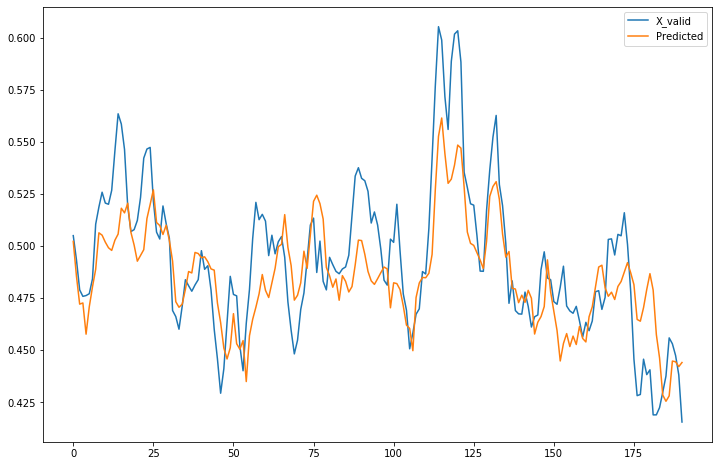

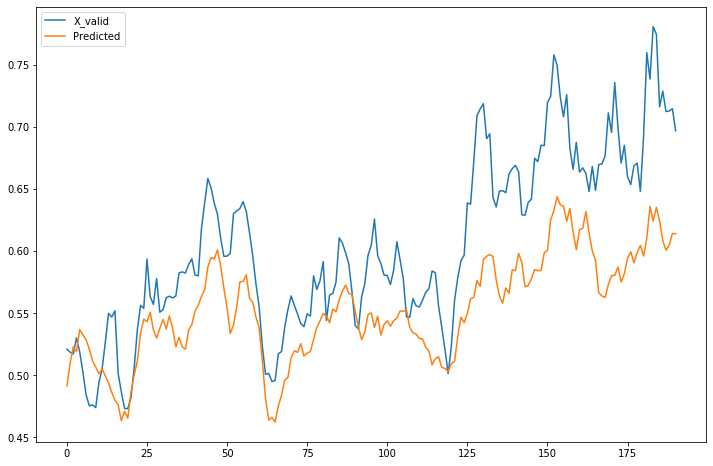

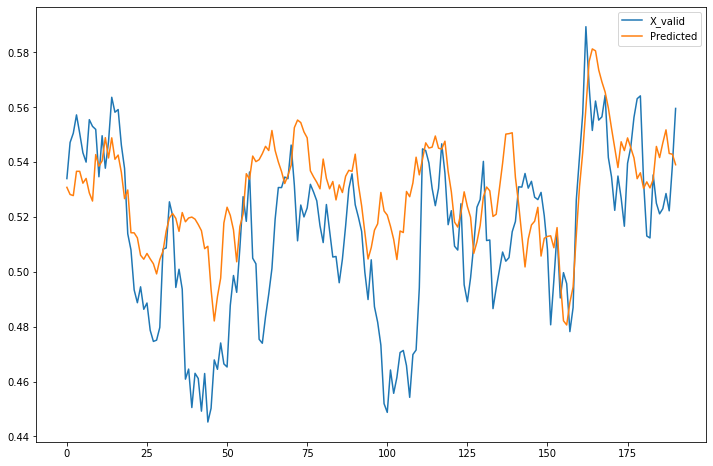

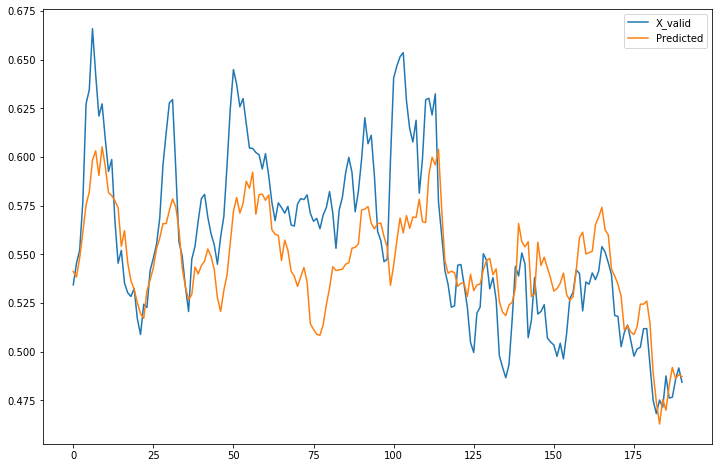

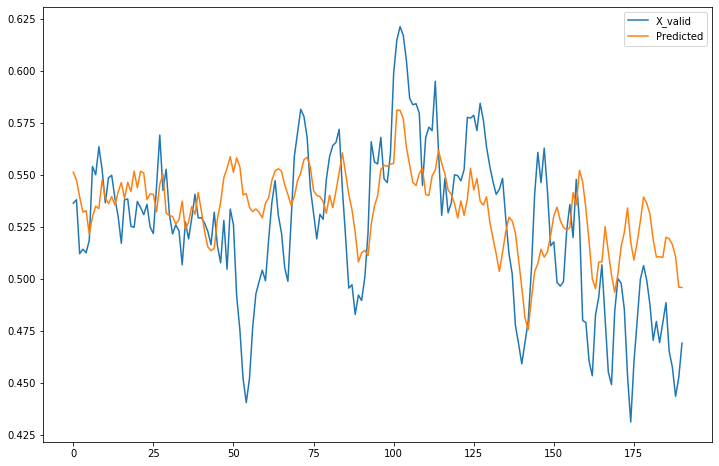

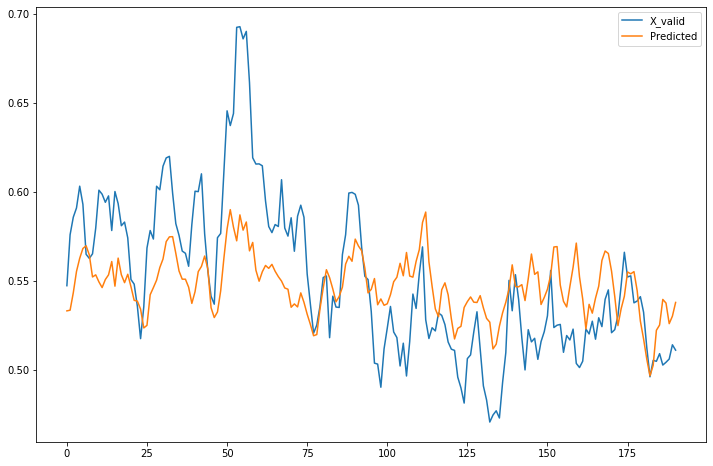

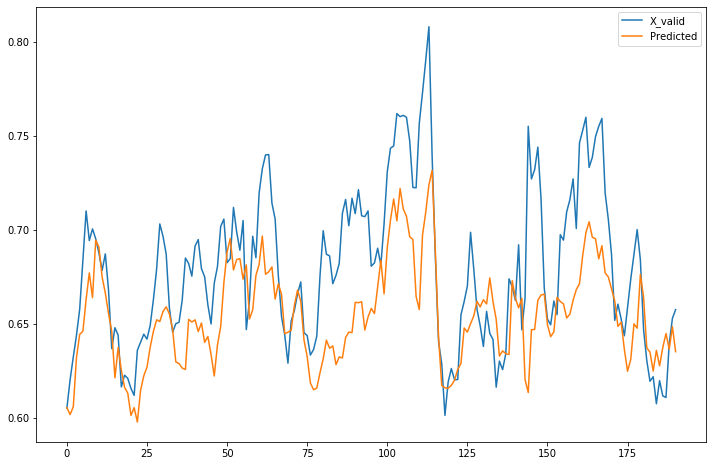

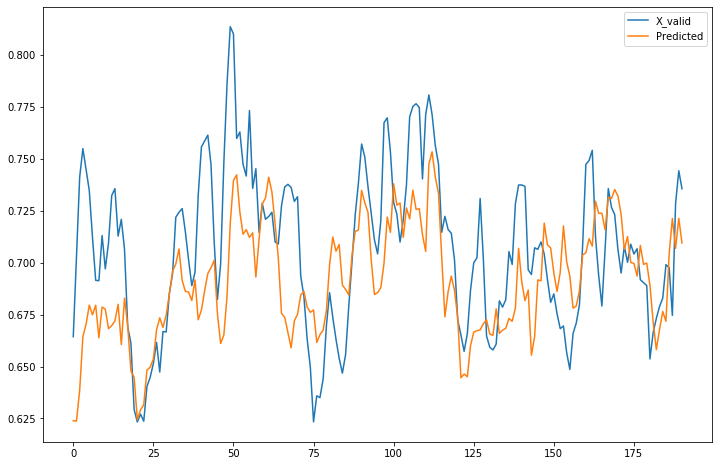

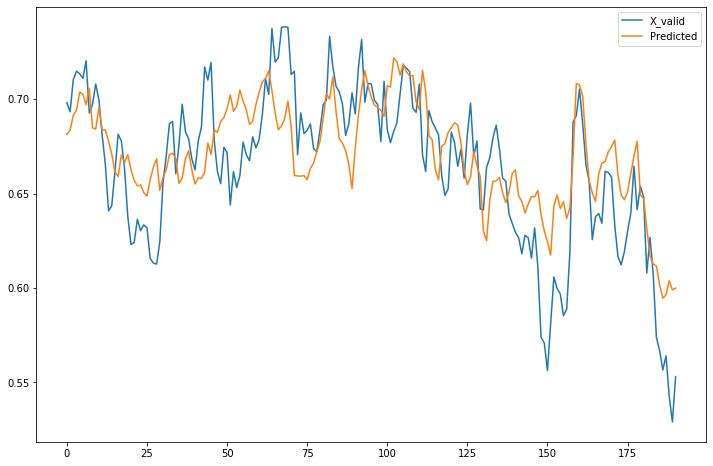

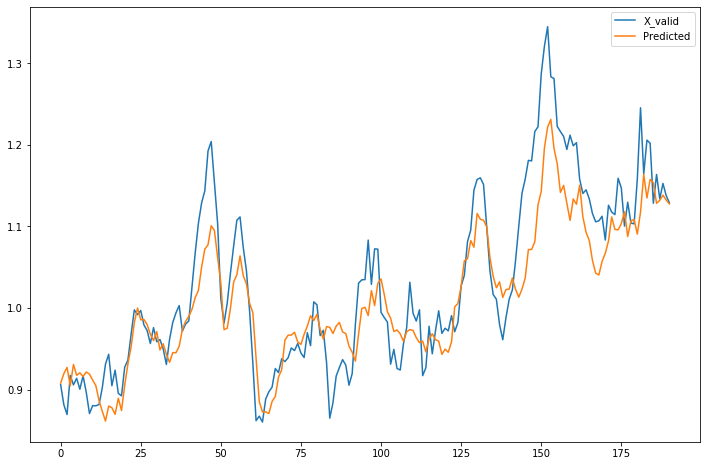

In [252]:
Predict = model.predict([X_valid,h_startv, c_startv])
for i in np.argsort(Y_valid)[:,-10:][0]:
    pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i],Predict[:,i]])),columns=["X_valid","Predicted"]).plot(figsize=(12,8))

#### ENC_LSTM LSTM Attention

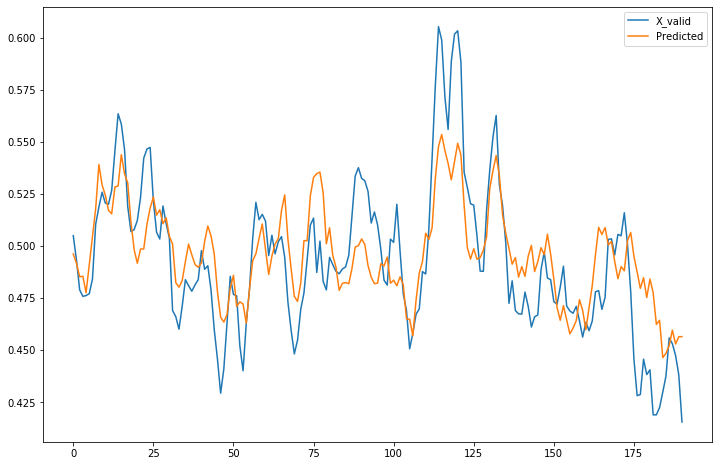

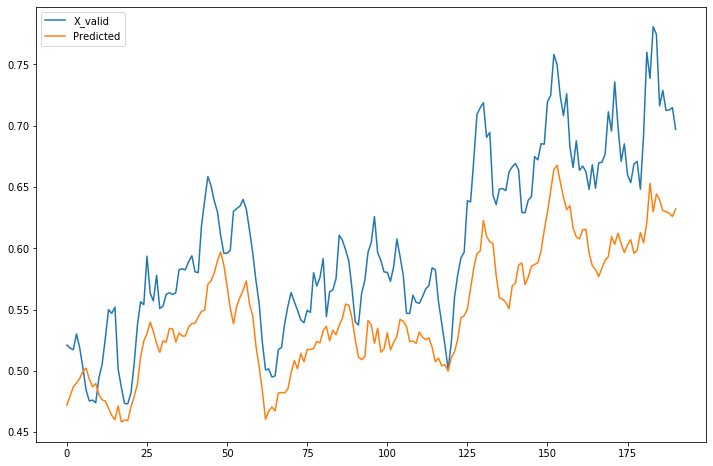

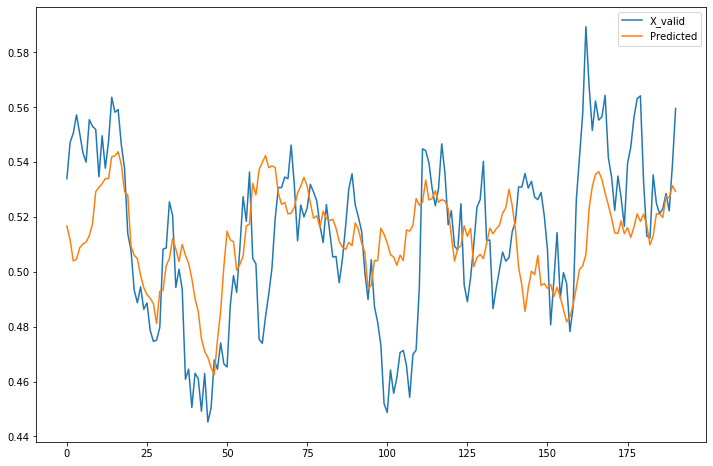

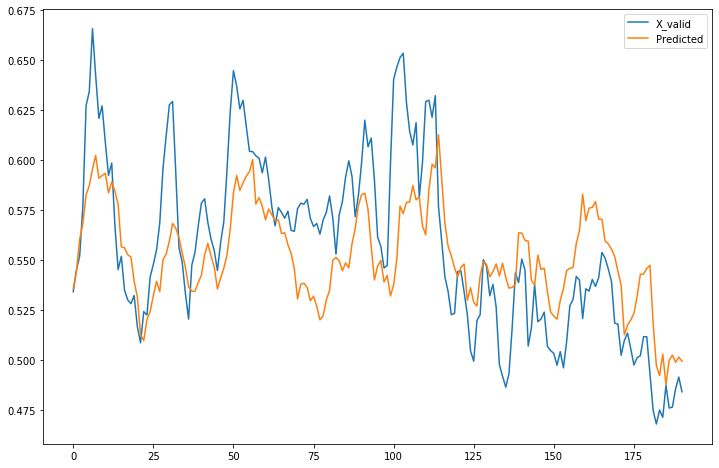

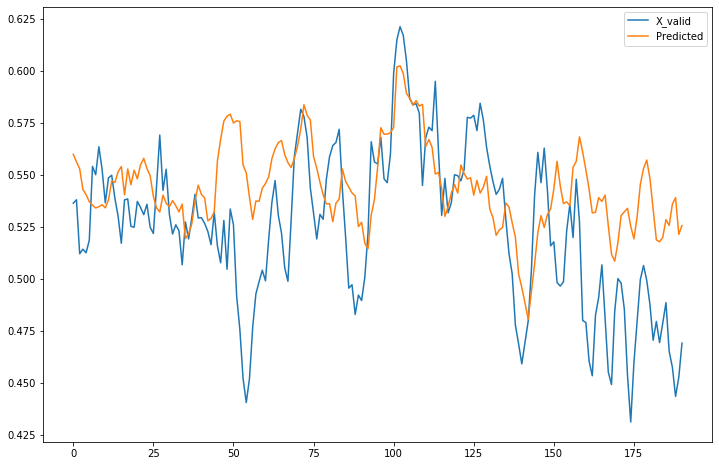

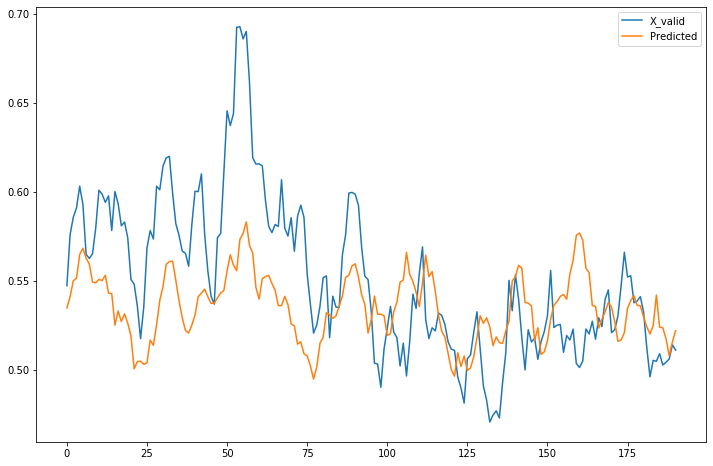

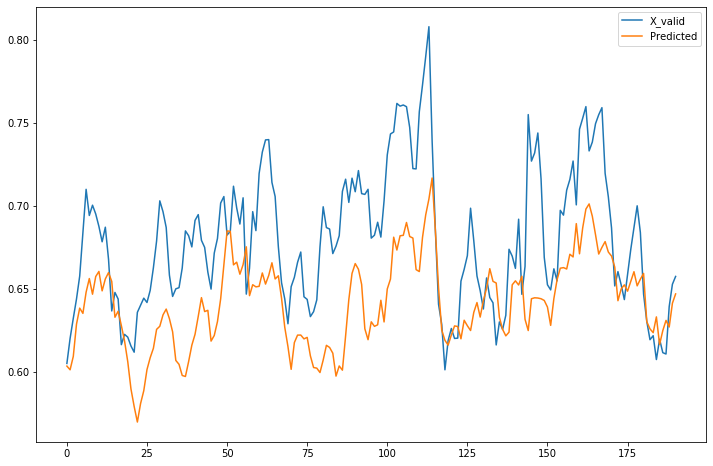

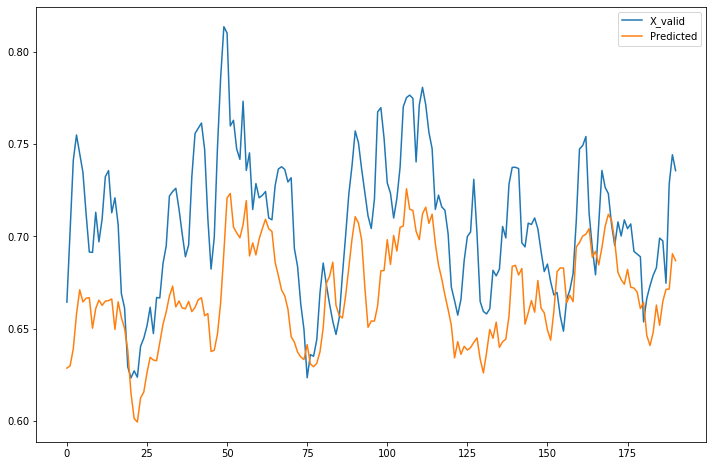

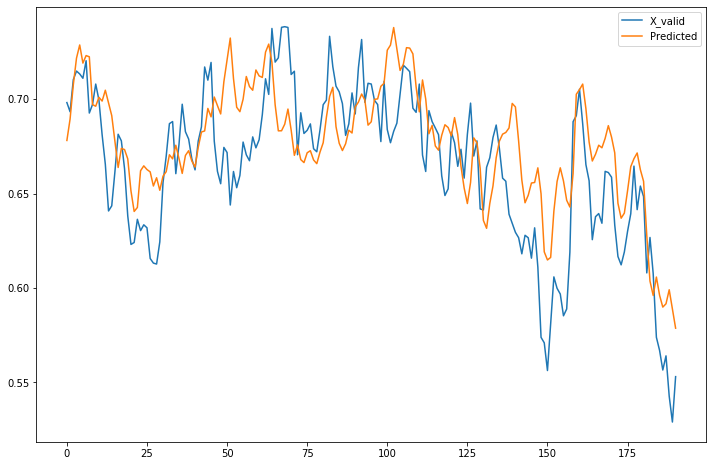

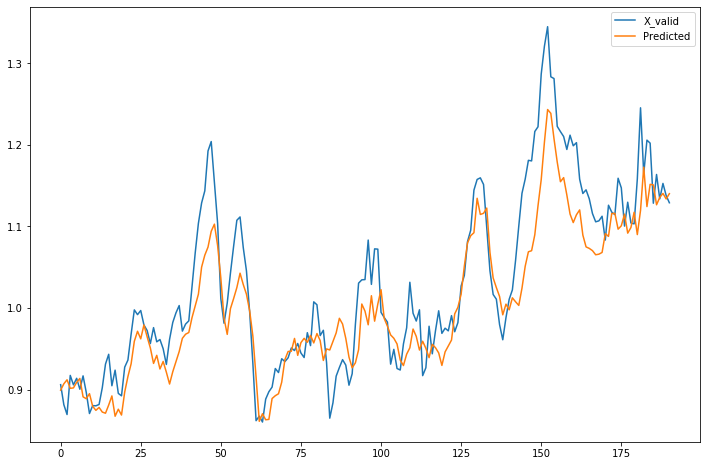

In [325]:
Predict = model.predict([X_valid,h_startv, c_startv])
for i in np.argsort(Y_valid)[:,-10:][0]:
    pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i],Predict[:,i]])),columns=["X_valid","Predicted"]).plot(figsize=(12,8))

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explic

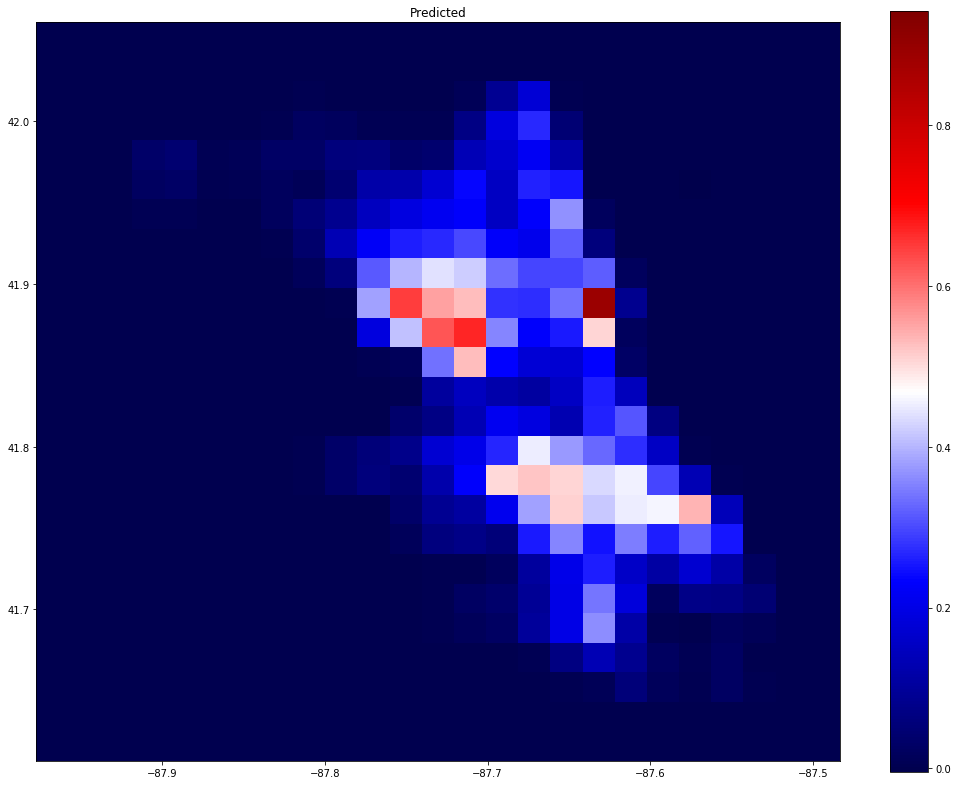

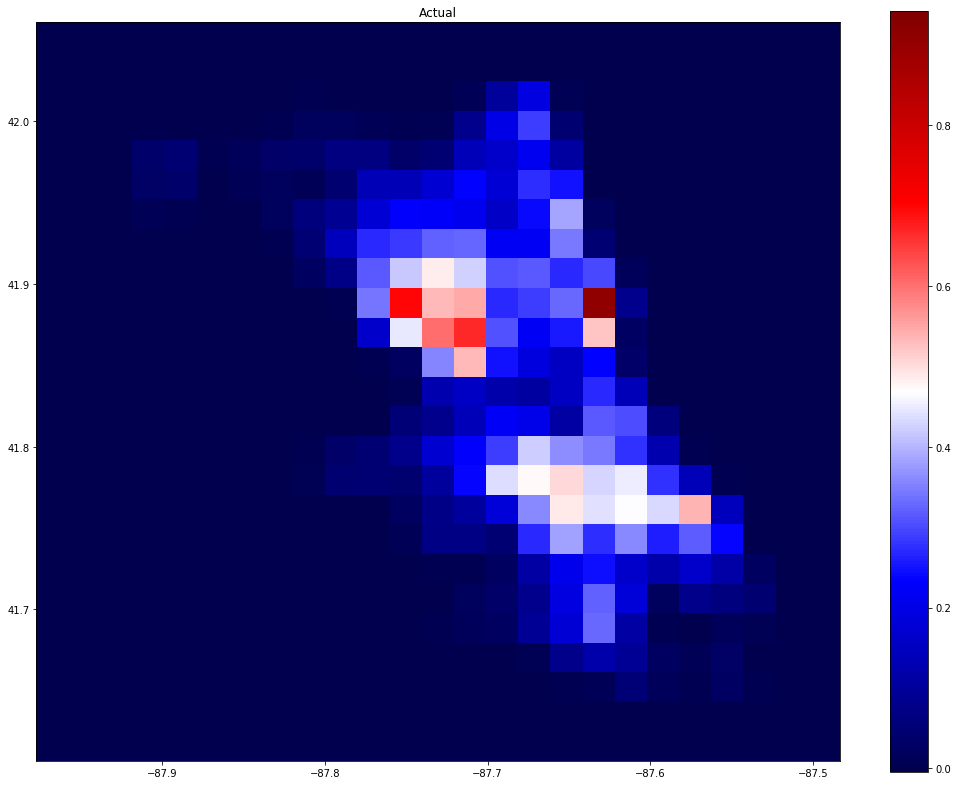

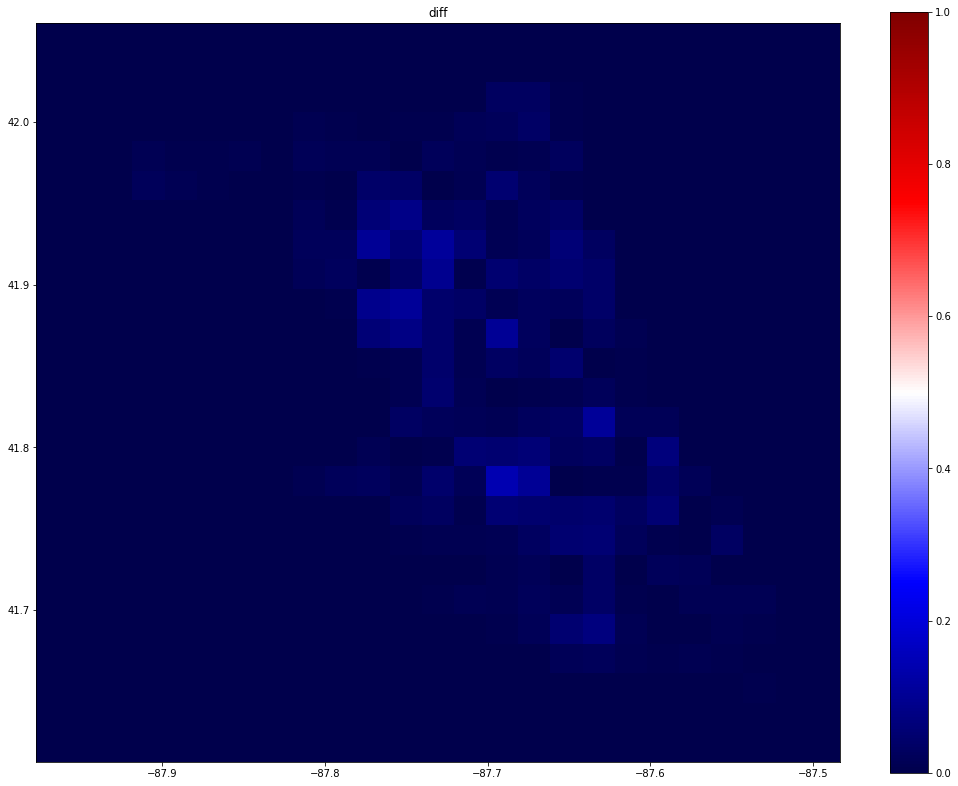

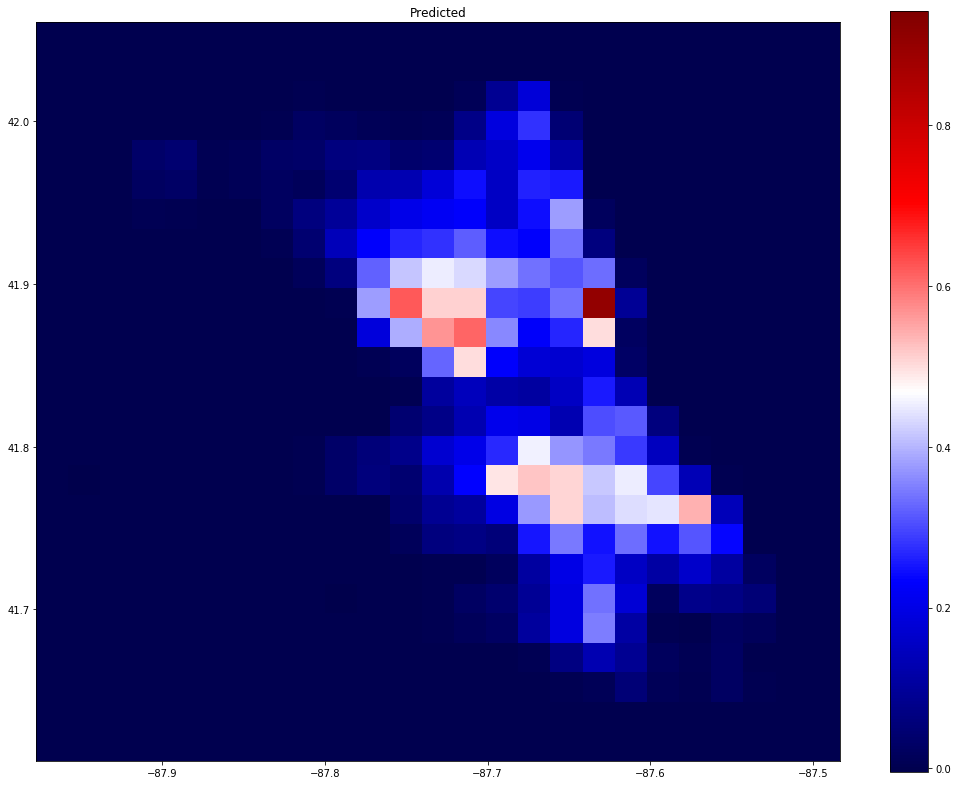

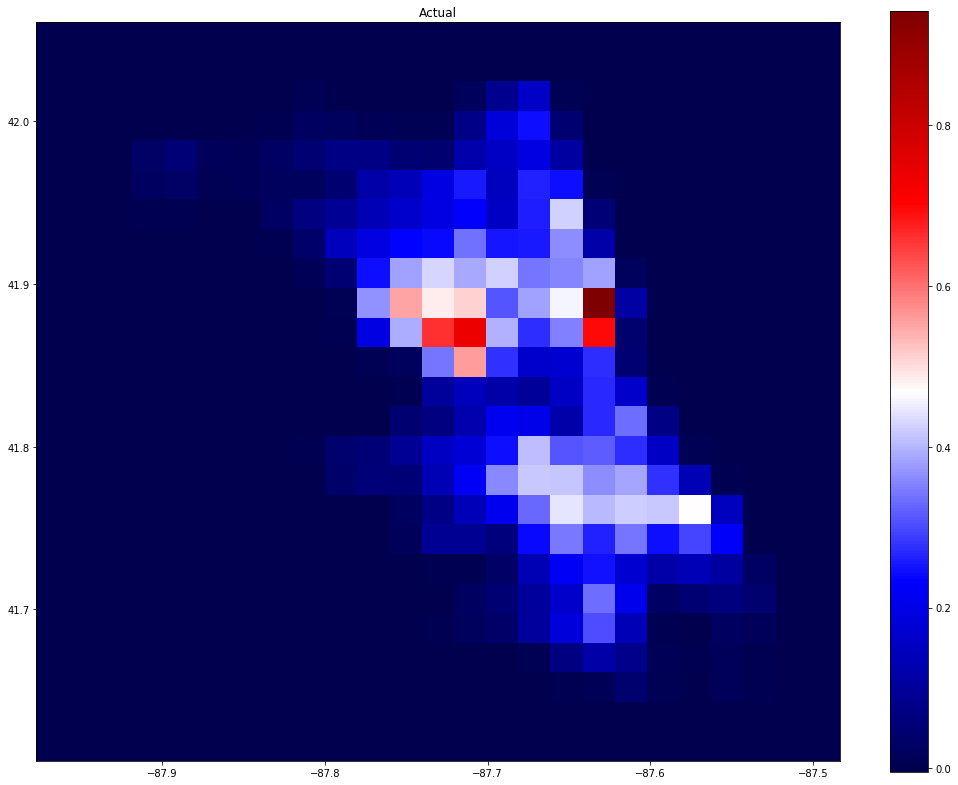

...

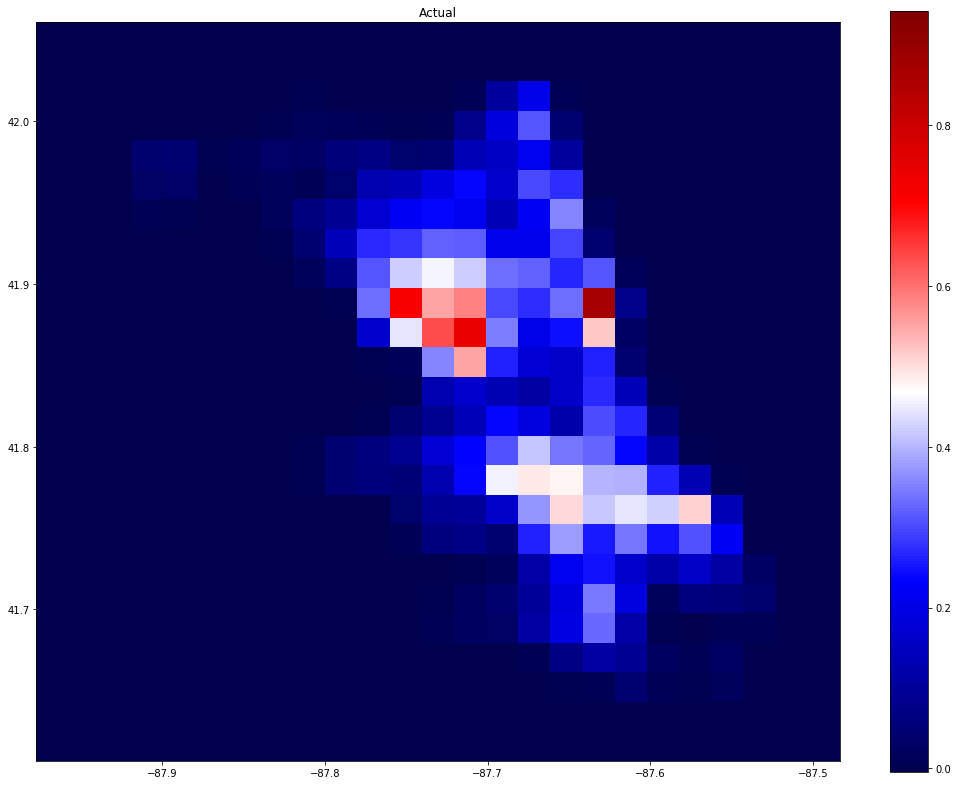

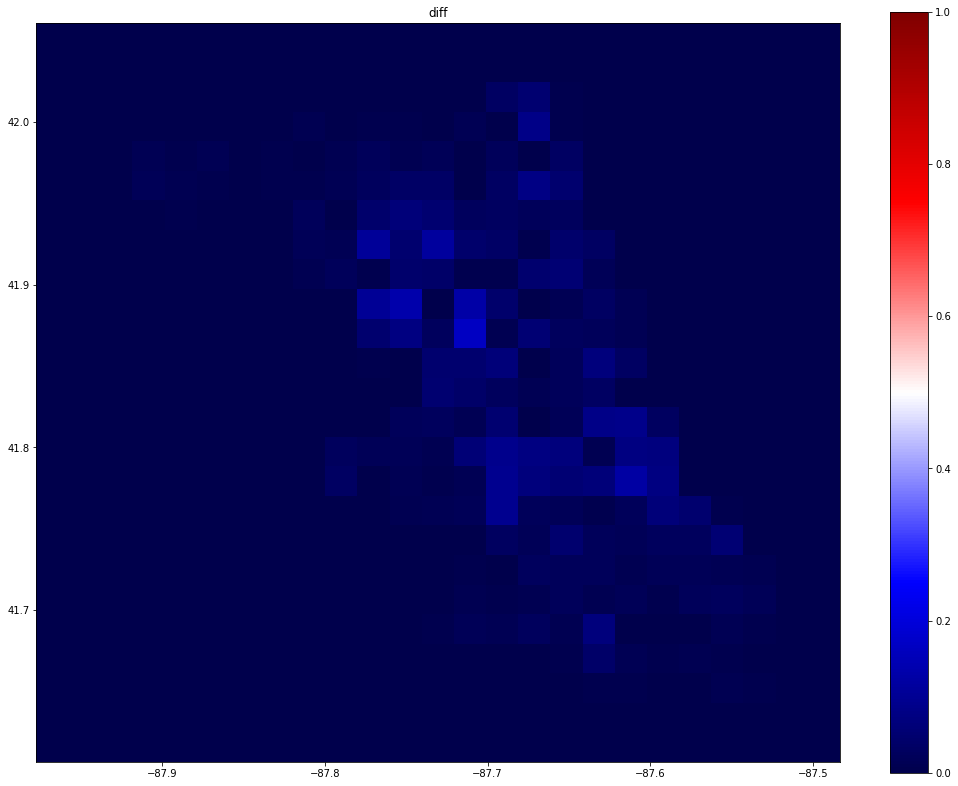

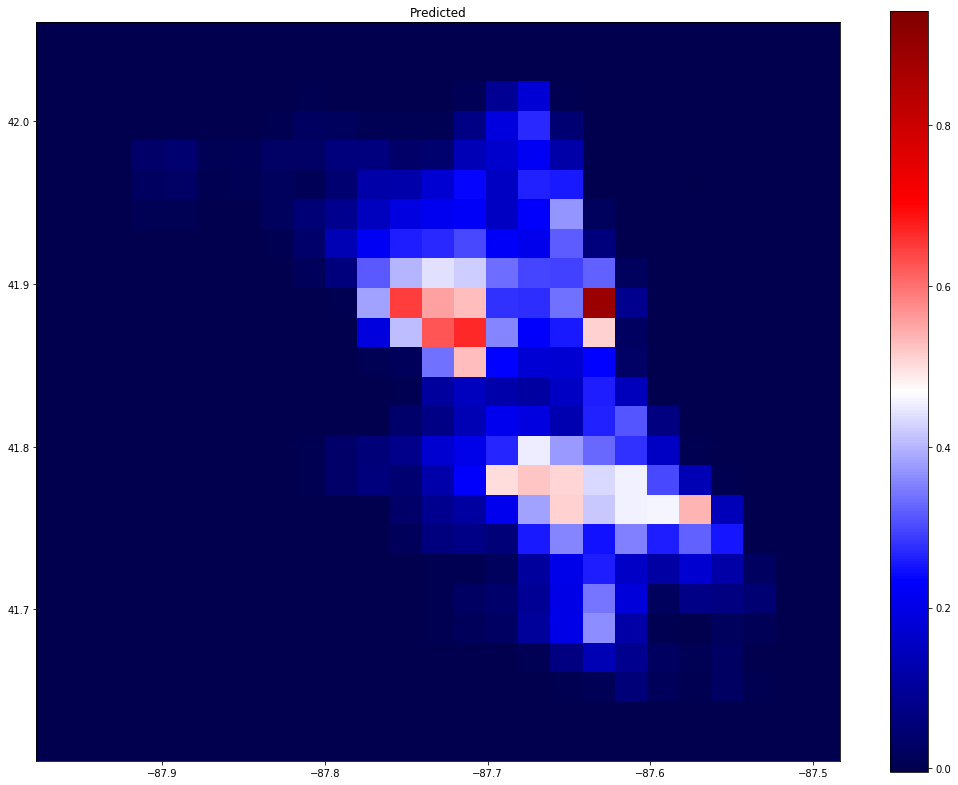

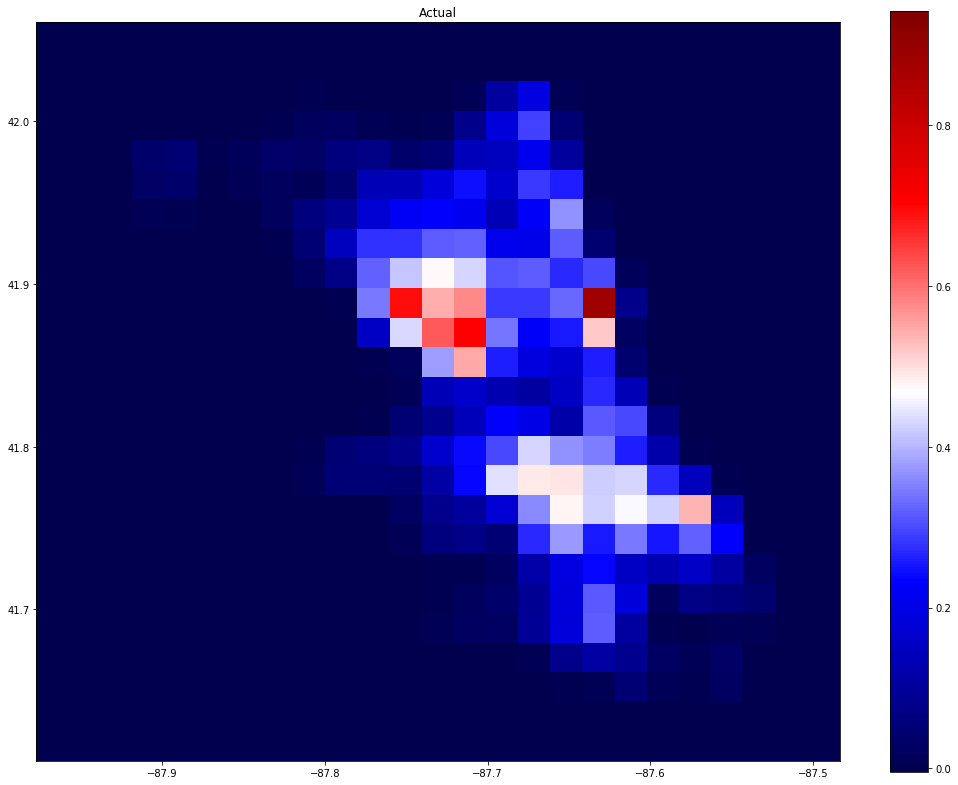

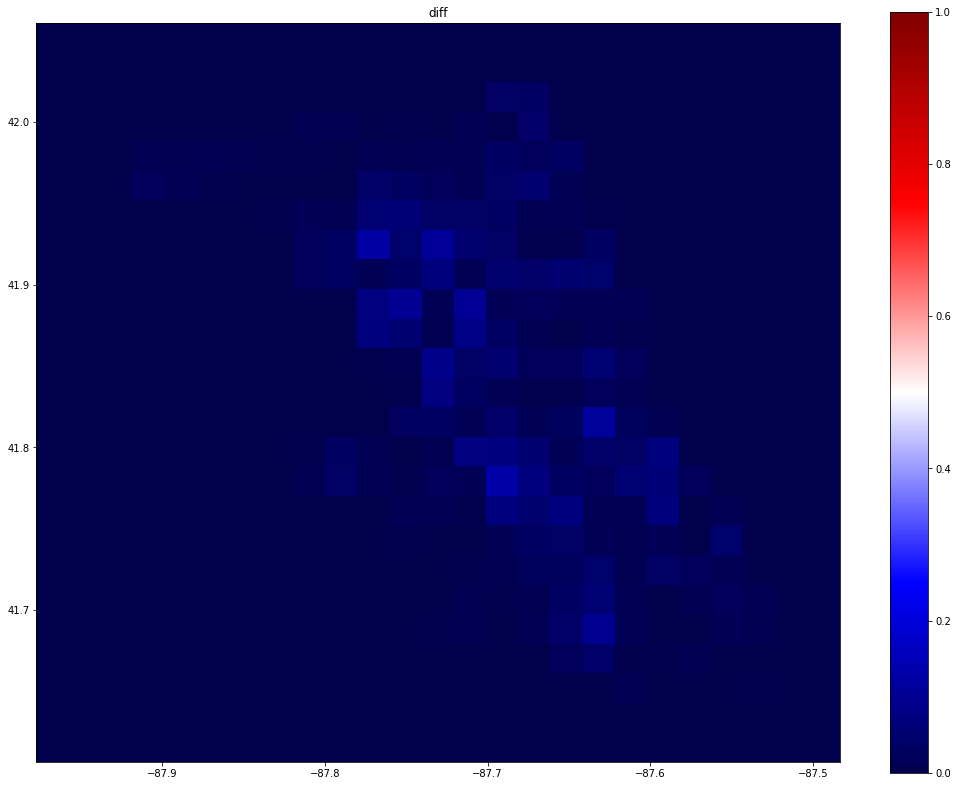

In [155]:
import matplotlib.pyplot as plt
grid_size = 500
density_matrix_t_series = []
# Define the borders
x = [-87.9361,-87.5245]
y = [41.6447,42.023]
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
xmin = min(x) - deltaX
xmax = max(x) + deltaX
ymin = min(y) - deltaY
ymax = max(y) + deltaY

for timeStepFromLast in range(Y_valid.shape[0]):
    plt.figure(figsize=(18, 14))
    plt.title('Predicted')
    plt.imshow( X=reshapePred(Predict,timeStepFromLast),vmax=vmax,vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()
    
    plt.figure(figsize=(18, 14))
    plt.title('Actual')
    plt.imshow( X=reshapePred(Y_valid,timeStepFromLast ),vmax=vmax,vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()
    
    diff = np.abs(reshapePred(Predict,timeStepFromLast)-reshapePred(Y_valid,timeStepFromLast ))
    plt.figure(figsize=(18, 14))
    plt.title('diff')
    plt.imshow( X=scaleDiff(diff,diff_max,diff_min),vmax=1,vmin=0, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()

#### We plot the single pixel with the most dense in crime KDE

In [282]:
Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]

array([-9.01753809e-04,  1.18319356e-02,  6.39541418e-03, -1.00963813e-03,
        2.21520226e-02,  9.82203294e-03,  8.98862978e-04, -1.40180189e-02,
       -2.85536782e-02, -1.55400392e-02,  2.49836335e-03, -6.25528683e-03,
        6.57367428e-03,  1.52411820e-02, -4.17035312e-03, -3.49904935e-03,
        1.69208642e-02, -6.37871144e-03,  3.80110476e-03,  3.35229609e-02,
        6.12156350e-03,  4.98861189e-04,  3.92699759e-03, -6.97102683e-03,
       -8.97786049e-03,  1.45726198e-02,  3.08736283e-03, -5.16823240e-03,
        4.67295254e-03, -1.55889985e-02, -1.86007998e-02, -5.75143199e-03,
       -4.28169510e-03,  5.93364074e-03,  7.45896358e-03, -3.70727537e-04,
        1.66578132e-02, -1.82307174e-02,  1.18449802e-03,  6.59418153e-03,
       -1.84222292e-02, -1.27048644e-02,  9.62644994e-03, -7.42424322e-03,
        6.96875199e-03,  2.01487532e-02,  3.60732578e-03,  2.75561154e-03,
       -5.55466216e-03, -1.54981214e-02, -1.23346509e-02,  3.42596063e-03,
        1.33056411e-02, -

In [283]:
[Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]
 ,Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]]

[array([-9.01753809e-04,  1.18319356e-02,  6.39541418e-03, -1.00963813e-03,
         2.21520226e-02,  9.82203294e-03,  8.98862978e-04, -1.40180189e-02,
        -2.85536782e-02, -1.55400392e-02,  2.49836335e-03, -6.25528683e-03,
         6.57367428e-03,  1.52411820e-02, -4.17035312e-03, -3.49904935e-03,
         1.69208642e-02, -6.37871144e-03,  3.80110476e-03,  3.35229609e-02,
         6.12156350e-03,  4.98861189e-04,  3.92699759e-03, -6.97102683e-03,
        -8.97786049e-03,  1.45726198e-02,  3.08736283e-03, -5.16823240e-03,
         4.67295254e-03, -1.55889985e-02, -1.86007998e-02, -5.75143199e-03,
        -4.28169510e-03,  5.93364074e-03,  7.45896358e-03, -3.70727537e-04,
         1.66578132e-02, -1.82307174e-02,  1.18449802e-03,  6.59418153e-03,
        -1.84222292e-02, -1.27048644e-02,  9.62644994e-03, -7.42424322e-03,
         6.96875199e-03,  2.01487532e-02,  3.60732578e-03,  2.75561154e-03,
        -5.55466216e-03, -1.54981214e-02, -1.23346509e-02,  3.42596063e-03,
         1.3

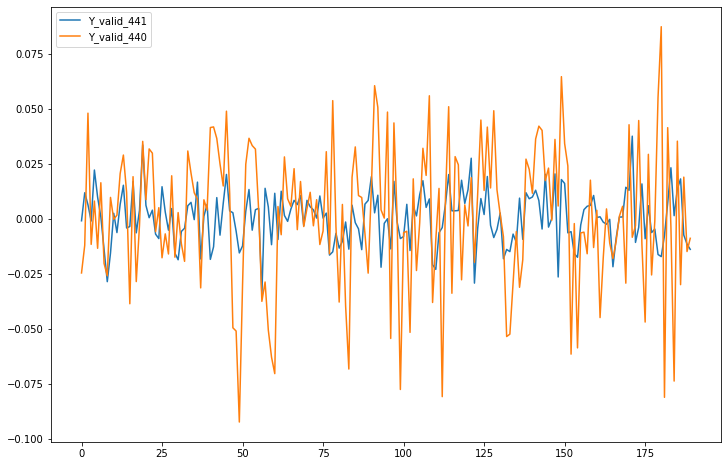

In [284]:
pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1],Y_valid[:,i][1:]-Y_valid[:,i][0:-1]])),columns=["Y_valid_"+str(i+1),"Y_valid_"+str(i)]).plot(figsize=(12,8))

In [182]:
for i in range(Predict.shape[0]-1):
    diff_ts = Predict[i,:] - Predict[i+1,:]
    print(np.sum(diff_ts[np.argsort(diff_ts)]))

-0.018348634
-0.016021848
0.015775248
0.020925283
0.045273706
0.03128943
0.018040925
-0.00502263
-0.02631709
-0.013405532
-0.0017083734
-0.013218492
0.0045014173
0.017989665
0.009978518
0.008973703
0.014333576
-0.0049110055
-0.020244107
-0.022466868
-0.040362597
-0.045676887
-0.024351493
0.019487843
0.04735197
0.0633508
0.053164914
0.013827905
-0.019466996
-0.028476924
-0.0130241215
0.02217567
0.04528658
0.046599343
0.03545305
0.0024482757
-0.01050134
-0.009597987
0.004566729
-0.008940145
-0.00509423
-0.005364269
-0.010164425
-0.015671536
-0.0077869743
-0.01051566
-0.049754962
-0.04241468
-0.028206766
-0.0001823008
0.07727072
0.061968148
0.01799655
-0.047201604
-0.07962313
-0.08635062
-0.01418215
0.005559683
0.053069443
0.056287825
0.03908366
-0.0066076815
-0.024781823
-0.035811573
-0.016936183
-0.00874117
0.021601647
0.0020243526
-0.0074737966
-0.008401036
-0.0012931526
0.028078198
0.038011193
0.017500311
0.005063951
-0.025907993
-0.036359817
-0.050627694
0.0023586303
-0.010886669
0.0

#### We plot the difference between prediction and target

In [183]:
diff = (reshapePred(Y_valid,3)-reshapePred(Predict,3))
diff.shape

(25, 25)

In [184]:
diff_max = np.max(diff)
diff_min = np.min(diff)
scaled_diff = (diff - diff_min)/(diff_max - diff_min)

In [185]:
np.max(scaled_diff)

1.0

In [186]:
diff

array([[-1.67235569e-03, -3.23733548e-04,  5.95766352e-04,
        -1.37537951e-04,  1.76841160e-04, -3.81134800e-04,
         2.69784126e-04,  1.77089707e-04,  1.05850736e-03,
         9.53653420e-04,  3.19143641e-04, -2.29958678e-05,
        -2.26227596e-04, -7.21998978e-04,  7.96711422e-04,
         1.71949388e-04,  3.67081026e-04, -2.15561362e-04,
         2.58697488e-04,  5.21506066e-04, -5.16083091e-05,
        -9.78268217e-04, -9.02256346e-04, -1.38947275e-03,
         7.24554178e-04],
       [ 2.90377066e-04,  7.12244539e-04, -4.19916818e-04,
         1.67926308e-04,  9.38627461e-04, -3.83002101e-04,
        -8.67697876e-04, -8.38714186e-06,  8.89419112e-04,
        -3.53584765e-05,  2.69406009e-05, -4.64310055e-04,
         5.50329569e-05, -1.67888240e-03,  1.70630403e-04,
        -2.00605951e-04,  1.23288529e-03, -1.12075359e-05,
         4.61907068e-04, -1.61501090e-03,  3.22510488e-04,
         7.08120642e-04,  1.06346037e-03,  3.36882658e-05,
        -1.00405794e-03],
    

In [187]:
vmax, vmin = np.max(scaled_diff), np.min(scaled_diff)

In [188]:
vmax, vmin 

(1.0, 0.0)

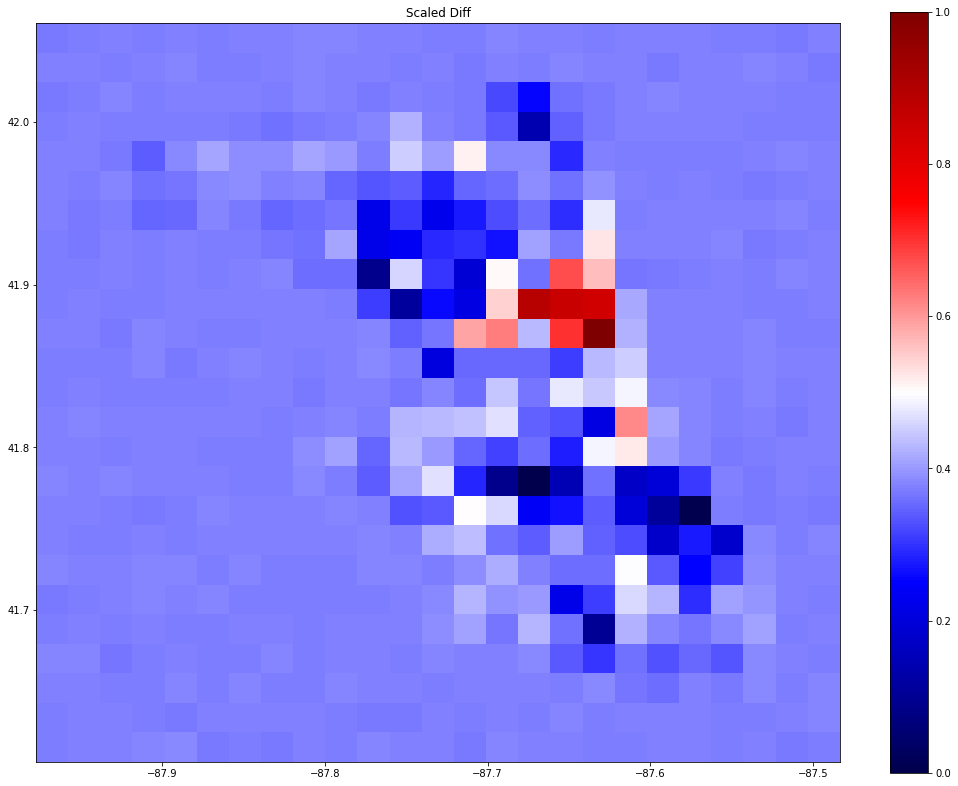

In [190]:
plt.figure(figsize=(18, 14))
plt.title('Scaled Diff')
plt.imshow( X=scaled_diff,vmax=vmax, vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
plt.colorbar()

#### Note the differences is scaled, red means extreme differences inplot above. Interestingly we see the extreme differences is at the highest crime areas.